# Visión por Computador - Proyecto Final


### Titulo : Segmentación de Áreas Afectadas en Hojas de Plantas para la Detección de Enfermedades

---
### Estudiantes
- Guillermo Ramblado 
- Pablo Ramblado 
- Nicolás Redondo 
- Carlos Bermúdez 

---
### Descripción del proyecto:
Este proyecto busca desarrollar un modelo que pueda detectar y segmentar automáticamente las áreas afectadas en hojas de plantas utilizando imágenes de alta resolución y sus máscaras. El modelo permitirá visualizar las zonas afectadas en cada hoja y calcular el porcentaje de área infectada, ofreciendo una herramienta de diagnóstico visual para el manejo agrícola.

El problema que se plantea es la segmentación de las partes infectadas de una hoja dada y calcular su porcentaje de infección. Para ello, hemos usado el dataset [ Leaf Disease Segmentation Dataset](https://www.kaggle.com/datasets/fakhrealam9537/leaf-disease-segmentation-dataset), que consta con 588 imágenes de diferentes hojas infectadas y sus respectivas máscaras de estas zonas de interés.

En primer lugar, enumeraremos a groso modo los pasos que hemos seguido para desarrollar el proyecto, no sin un previo apunte. Para poder calcular el porcentaje de infección, no solo es necesario conocer que parte de la hoja está infectada, sino también que parte de la imagen se corresponde a la propia hoja. Para solucionar este problema, realizamos diferentes pruebas, que comentaremos a continuación, pero adelantándonos a la conclusión, lo que mejor resultados nos dio fue realizar nuestras propias máscaras de cada hoja en si. Por ello, no solo contamos con el dataset citado, sino también con estas máscaras propias. Así pues, no contamos con un único modelo, sino con dos. El primero detecta la hoja infectada, y el segundo la zona infectada de la hoja. Las dos formas en que ambos se relacionan definen los dos enfoques que hemos adoptado y comparado para alcanzar nuestro objetivo. Ahora si, el proyecto queda estructurado de la siguiente forma:
##**1. Preeliminares**

###  1.1. Importación de bibliotecas
###  1.2. Declaración Funciones Auxiliares
###  1.3. Carga del Dataset
- Conjunto de imágenes de las hojas `images`
- Conjunto de máscaras de las hojas `leaf_mask`
- Conjunto de máscaras de las zonas infectadas `mask`

### 1.4. Preprocesamiento de las máscaras: Conversión de las máscaras en máscaras binarias

## **2. Formas de abordar el problema**
Como citamos, el procedimiento que definimos consta de dos partes, una primera fase de segmentación de la hoja infectada + fase de segmentación de zona infectada.
### 2.1. Segmentación de la hoja

#### 2.1.1.Segmentar la hoja manualmente:
- Cambio a un espacio de colores alternativo.
- Detección de bordes

#### 2.1.2. Segmentación automática, entrenamiento de un modelo que segmenta la hoja infectada de la imagen `leaf_segmentation_model`
Por ello, nuestro procedimiento no consta de un único modelo.

### 2.2. Segmentación zona infectada
###  2.2.1. Primera forma de abordar el problema `leaf_disiase_segmentation_model`
El procedimiento que se nos ocurrió y que se sigue en este apartado, se basa en la idea de entrenar el segundo modelo, (detección de zona infectada de la hoja) usando como imágenes las del dataset pero aplicándoles las máscaras generadas por el modelo de segmentación de hojas.

###  2.2.2. Segunda forma de abordar el problema
En este caso, entrenamos el modelo que segmenta la zona infectada con las imágenes directamente del dataset. `disease_segmentation_model`

## **3. Resultados**
### 3.1. Comparación de resultados
### 3.2. Segmentación zonas infectadas y porcentajes


Primero, es necesario cargar las imágenes del dataset disponible en Kaggle: [Leaf disease segmentation dataset](https://www.kaggle.com/datasets/fakhrealam9537/leaf-disease-segmentation-dataset).

Para ello debemos asegurarnos de que las imágenes estén ubicadas en una carpeta llamada `leaf_data`, la cual debe encontrarse en la ruta exacta `/content/drive/My Drive/leaf_data` de nuestro Google Drive.

In [ ]:
# Ahora configuramos Fastai
!pip install -Uqq fastbook
!pip install nbdev
import fastbook
fastbook.setup_book()
import fastai
import fastcore
print(f'fastcore version {fastcore.__version__} installed')
print(f'fastai version {fastai.__version__} installed')
from nbdev.showdoc import *
from fastai.vision.all import *

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 719.8/719.8 kB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 480.6/480.6 kB 16.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.3/179.3 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 15.9 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gcsfs 2024.10.0 requires fsspec==2024.10.0, but you have fsspec 2024.9.0 which is incompatible.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.3/44.3 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.1/69.1 kB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━

Importar librerias necesarias

In [ ]:
from google.colab import drive
import os
import matplotlib.pyplot as plt
import numpy as np
import cv2
import shutil
import random
from fastai.vision.all import *
from PIL import Image
from pathlib import Path
from fastai.learner import load_learner
from fastai.losses import BCEWithLogitsLossFlat
import torch

# Montar Google Drive
drive.mount('/content/drive')

Mounted at /content/drive


Creamos funciones externas proporcionadas por el profesor en anteriores prácticas.

In [ ]:
'''
This function receives an array of arbitrary real numbers (that could include even negative values),
and returns an 'image' in the range [0,1].
flag_GLOBAL allows the user to normalize the whole image (including all channels) or to normalize
each channel/band independently.
'''
def rangeDisplay01(im, flag_GLOBAL= True):
  im = im.astype(float)
  if flag_GLOBAL:
    im = (im - im.min())/(im.max() - im.min())
  else:
    # bands normalization
    for band in range(im.shape[2]):
      im[:, :, band] = (im[:, :, band] - im[:, :, band].min())/(im[:, :, band].max() - im[:, :, band].min())
      # Note: remember that, for plt.imshow with RGB data, the valid range is [0..1] for floats and [0..255] for integers.
  return im

In [ ]:
'''
This function displays a single image, including a title, using a magnification factor.

Example of use:
im1=readIm(get_image('apple.jpg'),0)
displayIm(im1,'Manzana',0.5)

'''
def displayIm(im, title='Result',factor= 2):
  # First normalize range
  max=np.max(im)
  min=np.min(im)
  if min<0 or max>255:
    im=rangeDisplay01(im,flag_GLOBAL=True)
  if len(im.shape) == 3:
    # im es tribanda
    plt.imshow(im, cmap='jet')
  else:
    # im es monobanda
    plt.imshow(im, cmap='gray')
  figure_size = plt.gcf().get_size_inches()
  plt.gcf().set_size_inches(factor * figure_size)
  plt.title(title)
  plt.xticks([]), plt.yticks([]) # eliminamos numeración
  plt.show()

In [ ]:
'''
This function displays multiple images (including a title and using a magnification factor)
of equal size. The input to the function is a list of images.

Example of use:
im1=readIm(get_image('apple.jpg'),1)
images = [im1,im1,im1]

displayMI_ES(images, title='Manzanas',factor=1)

'''
def displayMI_ES(vim, title='Result',factor=2):
  # We set the maximun number of images to concatenate by columns
  maxcolumns=3
  # number of images to display
  numberim=len(vim)
  # The simplest case, one row: the maximum number of columns is larger than the images to stack
  # This is, by default, we put together the images column-wise
  if len(vim) < maxcolumns:
    out=vim[0]
    for item in range(1,len(vim)):
      #displayIm(out,str(item),1)
      out=np.hstack((out,vim[item]))

  # Else, if maxcolumns is smaller or equal than the number of images to stack
  else:
    # We check if all rows and columns are going to be 'busy', or if otherwise we need an extra-row
    if np.mod(len(vim),maxcolumns)== 0:
      maxrows=numberim//maxcolumns
    else:
      maxrows=numberim//maxcolumns+1

    # we build up the first block-row
    out=vim[0]
    for item in range(1,maxcolumns):
      out=np.hstack((out,vim[item]))
    # We build up the rest of block-rows
    for block in range(1,maxrows):
      #print(block)
      row=vim[block*maxcolumns]
      for item in range(1,maxcolumns):
        # We still have images to stack
        if block*maxcolumns+item < numberim:
          row=np.hstack((row,vim[block*maxcolumns+item]))
        # We do not have more images, and we have to fill with black
        else:
          row=np.hstack((row,np.zeros(vim[0].shape,dtype=vim[0].dtype)))
          #print(row.dtype)
          # if we don't include ',dtype=vim[0].dtype', np.zeros will include float
          # numbers in the matrix. This will make that the whole matrix will be
          # considered as floats, and values larger than 1 will be clipped to 1,
          # displaying an almost totally white image
      # add the new block-row
      out=np.vstack((out,row))
  return displayIm(out,title,factor)

In [ ]:
# Function to display evaluation metrics
# Developed by Ignacio Oguiza: https://forums.fast.ai/t/plotting-metrics-after-learning/69937

@patch
@delegates(subplots)
def plot_metrics(self: Recorder, nrows=None, ncols=None, figsize=None, **kwargs):
    metrics = np.stack(self.values)
    names = self.metric_names[1:-1]
    n = len(names) - 1
    if nrows is None and ncols is None:
        nrows = int(math.sqrt(n))
        ncols = int(np.ceil(n / nrows))
    elif nrows is None: nrows = int(np.ceil(n / ncols))
    elif ncols is None: ncols = int(np.ceil(n / nrows))
    figsize = figsize or (ncols * 6, nrows * 4)
    fig, axs = subplots(nrows, ncols, figsize=figsize, **kwargs)
    axs = [ax if i < n else ax.set_axis_off() for i, ax in enumerate(axs.flatten())][:n]
    for i, (name, ax) in enumerate(zip(names, [axs[0]] + axs)):
        ax.plot(metrics[:, i], color='#1f77b4' if i == 0 else '#ff7f0e', label='valid' if i > 0 else 'train')
        ax.set_title(name if i > 1 else 'losses')
        ax.legend(loc='best')
    plt.show()

La carpeta `leaf_data` se compone de 2 subcarpetas principales: `images`, que contiene imágenes de plantas con enfermedades, y `mask`, que contiene las máscaras correspondientes que resaltan, sobre un fondo negro, las áreas afectadas por la enfermedad en blanco.

Además, cargamos una carpeta adicional que contiene las máscaras de segmentación correspondientes a las imágenes de las hojas. Estas máscaras son imágenes binarias que marcan las áreas afectadas por la enfermedad en las hojas, donde las zonas enfermas están resaltadas (blanco, con valor 1), y el resto de la imagen (las áreas sanas o el fondo) se establece en negro (valor 0).

Dado que las imágenes en `images` y sus máscaras en `mask` comparten el mismo nombre (y ambos ordenados alfabéticamente), con la diferencia de que las imágenes están en formato `.jpg` y las máscaras en formato `.png`, podemos asegurarnos de que cada imagen tenga su máscara correspondiente al dividir los datos en conjuntos de entrenamiento y validación.

In [ ]:
# Crear las rutas para las imágenes y máscaras con data augmentation
base_path_data = "/content/drive/MyDrive/leaf_segmentation/leaf_data/data"
images_path = Path(base_path_data) / "images"
masks_path = Path(base_path_data) / "masks"
leaf_masks_path = Path(base_path_data) / "masks_leaf"

# Comprobar el acceso a las carpetas
def check_access(path):
  if os.path.exists(path) and os.path.isdir(path):
    print(f"Acceso correcto al directorio: {path}")
    return True
  print(f"Error: No se puede acceder a la carpeta: {path}")
  return False

# Verificar que ambas carpetas 'images' y 'mask' existen
if not check_access(images_path) or not check_access(masks_path) or not check_access(leaf_masks_path):
    raise SystemExit("No se pudo acceder a las carpetas necesarias. Verifica las rutas.")

Acceso correcto al directorio: /content/drive/MyDrive/leaf_segmentation/leaf_data/data/images
Acceso correcto al directorio: /content/drive/MyDrive/leaf_segmentation/leaf_data/data/masks
Acceso correcto al directorio: /content/drive/MyDrive/leaf_segmentation/leaf_data/data/masks_leaf


Comprobamos que haya el mismo número de archivos para `images`, `mask` y `leaf_mask`.

In [ ]:
# Obtener archivos de imagen y máscaras
image_files = get_image_files(images_path)
mask_files = get_image_files(masks_path)
leaf_mask_files = get_image_files(leaf_masks_path)

print(f'Images : {len(image_files)} archivos')
print(f'Disease masks : {len(mask_files)} archivos')
print(f'Leaf masks : {len(leaf_mask_files)} archivos')

Images : 588 archivos
Disease masks : 588 archivos
Leaf masks : 588 archivos


In [ ]:
# Función para obtener la ruta de la máscara correspondiente
def get_mask_fn(image_path, leaf_mask=False):
  if(leaf_mask):
    return leaf_masks_path / f"{image_path.stem}.png"
  else:
    return masks_path / f"{image_path.stem}.png"

Mostramos las imágenes junto a sus respectivas máscaras. Para ello, hacemos uso de `plt.imshow()`, con los siguientes parámetros:

* `cmap` : **mapa de colores** a emplear. Nosotros usaremos **gray**
* `norm` : método de normalización empleado para escalar los valores al rango [0,1] antes de mapearlos sobre los colores usando `cmap`. Por defecto, se normaliza de tal forma que el mínimo valor en la imagen va a parar al 0, mientras que el máximo va a parar al 1.
* `vmin`, `vmax` : Estos parámetros determinan el **rango de valores que el mapa de colores cubre**, siempre que no se especifique una normalización.

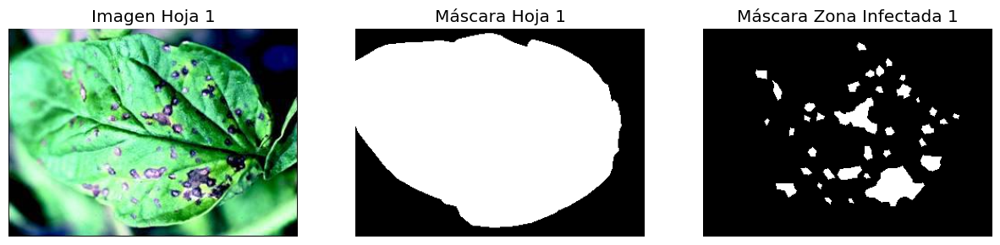

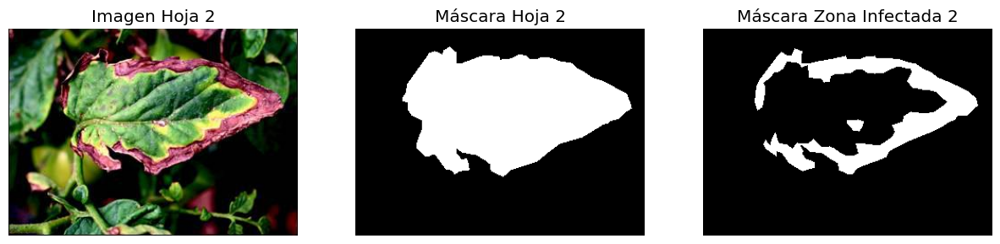

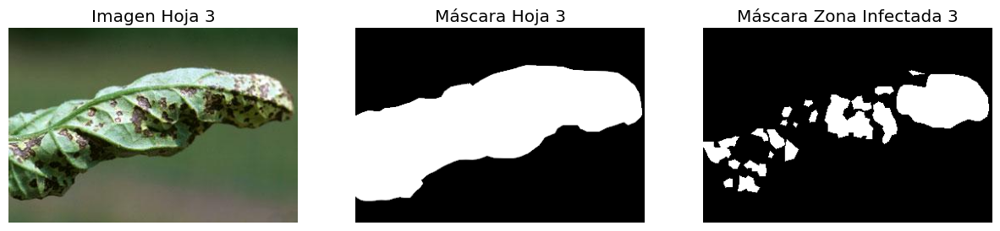

In [ ]:
def show_images_masks(num_images = 5):
  # Mostrar las primeras 5 imágenes y sus máscaras
  for i in range(0, len(image_files[:num_images])):  # Limitar a las primeras 5 imágenes
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))

    # Mostrar la imagen
    img = cv2.imread(str(image_files[i]))
    ax[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))  # Convertir BGR a RGB
    ax[0].set_title(f"Imagen Hoja {i+1}")
    ax[0].set_axis_off()

    #Obtener y mostrar la máscara de la hoja
    #print(f"Mask file: {get_mask_fn(image_files[i])}")
    mask_leaf_fn = get_mask_fn(image_files[i],True)
    mask_leaf = cv2.imread(str(mask_leaf_fn), cv2.IMREAD_GRAYSCALE)

    ax[1].imshow(mask_leaf, cmap='gray')
    ax[1].set_title(f"Máscara Hoja {i+1}")
    ax[1].set_axis_off()

    #Obtener y mostrar la máscara de la zona infectada
    mask_fn = get_mask_fn(image_files[i])
    mask = cv2.imread(str(mask_fn), cv2.IMREAD_GRAYSCALE)

    ax[2].imshow(mask, cmap='gray')
    ax[2].set_title(f"Máscara Zona Infectada {i+1}")
    ax[2].set_axis_off()

    plt.show()
    print("\n")

# Ejecutamos la función
show_images_masks(3)

Nota : A la hora de visualizar una máscara, podemos proceder de dos formas :
1. Usar `cv2.imread(...)` para cargar la máscara en escala de grises, y posteriormente, visualizarla usando `plt.imshow(mascara,cmap='gray')`
2. Cargar la imagen en formato **PILMask**, usando `PILMask.create(ruta_mascara)`, y posteriormente, usar el método `.show` de la clase PILMask. De esta forma, se interpretará cada valor empleado como una clase, asociando a cada clase un color diferente.

# **Preprocesamiento de las máscaras proporcionadas**

En un problema de segmentación binaria (dos clases), es obligatorio que los píxeles de las máscaras empleadas tomen únicamente dos posibles valores, más especificamente, 0's y 1's.

In [ ]:
mask = cv2.imread(get_mask_fn(image_files[0]), cv2.IMREAD_GRAYSCALE) #Leemos máscara en escala de grises
print(f"Mask values: {len(np.unique(mask))} ({np.unique(mask)})")

Mask values: 2 ([ 0 38])


Además, este mismo problema ocurre para las máscaras de las hojas segmentadas. Con la diferencia de que cada imagen puede tener valores muy variados, aun así seguiremos el mismo proceso que las máscara de las imágenes para trasnformarlas a binario. Sobre todo estos valores son notables en los bordes de las hojas.

Leaf mask 1 values: 2 ([ 26 242])
Leaf mask 2 values: 95 ([  0 133 135 138 139 142 143 144 145 146 147 148 149 150 151 153 155 157 158 159 160 161 163 164 165 166 167 168 169 170 172 173 174 175 177 178 179 180 181 182 183 184 185 186 187 188 189 191 192
 193 194 195 196 198 200 201 202 203 204 205 206 207 208 209 212 213 214 215 217 218 219 220 222 223 224 225 226 227 229 231 232 233 236 237 239 240 243 244 245 246 247 248 249 251 255])


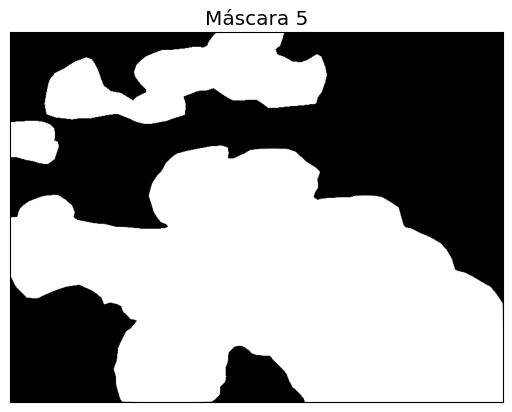

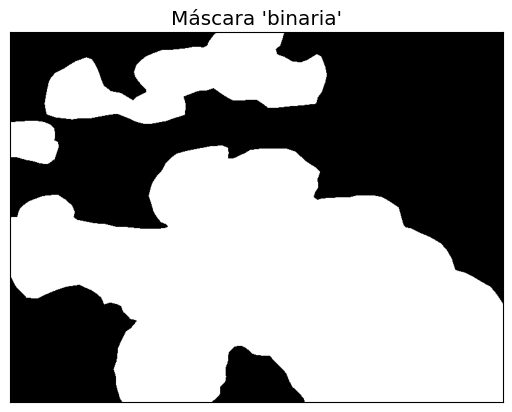

Leaf mask 2 values: 2 ([0 1])


In [ ]:
mask_1 = cv2.imread(leaf_mask_files[0], cv2.IMREAD_GRAYSCALE)
mask_2 = cv2.imread(leaf_mask_files[4], cv2.IMREAD_GRAYSCALE)
print(f"Leaf mask 1 values: {len(np.unique(mask_1))} ({np.unique(mask_1)})")
print(f"Leaf mask 2 values: {len(np.unique(mask_2))} ({np.unique(mask_2)})")
displayIm(mask_2, title="Máscara 5", factor=1)

im = mask_2.copy()
min = np.min(im)
im[im != min] = 1
im[im == min] = 0
displayIm(im, title="Máscara 'binaria'", factor=1)
print(f"Leaf mask 2 values: {len(np.unique(im))} ({np.unique(im)})")

A modo de ejemplo, obtenemos, sin repeticiones, los valores que contienen los píxeles de la primera máscara. Como se puede apreciar, se obtienen los valores $0$ y $38$. En este caso, para lograr que los píxeles se mapeen correctamente a su respectiva clase (no infectado e infectado), será necesario hacer una conversión de 38 a 1. De esta forma:
* Todos aquellos píxeles con un **valor nulo** (0) se identificarán con la clase **no infectado**
* Todos aquellos píxeles con un **valor de 1** se identificarán con la clase **infectado**

Antes de realizar esta conversión, comprobemos que las máscaras restantes emplean únicamente dos valores, y justamente los mismos que emplea la primera máscara.

In [ ]:
errores = 0

for i in range(len(mask_files)):
  msk=cv2.imread(mask_files[i], cv2.IMREAD_GRAYSCALE)
  if len(np.unique(msk))>2:
    errores+=1

print(f"Se han encontrado {errores} máscaras distintas")

Se han encontrado 276 máscaras distintas


A diferencia de la primera máscara, que contenía únicamente dos valores, 0 y 38, existen otras máscaras que contienen muchos más valores, no únicamente esos dos.

Este problema se puede apreciar visualmente cargando cualquiera de las máscaras con este problema, en formato **PILMask**, y usando el método `.show`.

<Axes: >

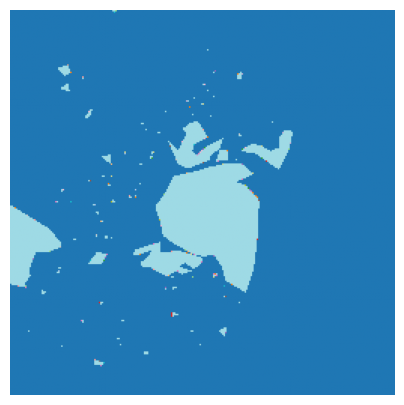

In [ ]:
PILMask.create(mask_files[-1]).show(figsize=(5,5), alpha=1)

Tal y como se aprecia en la imagen, no se aplican únicamente dos colores, sino muchos más, en especial, para pintar los píxeles que delimitan la zona infectada, que son los que realmente generan este problema.

Optamos por poner a $1$ todos aquellos píxeles con un valor no nulo. Procedemos a crear el método encargadado de devolver la máscara binaria de una determinada hoja, teniendo en cuenta lo anteriormente comentado.

Tambien haremos esto para la máscara de la hoja segmetada, teniendo en cuenta que el valor mínimo será considerado 0 (negro) y todo valor mayor que ese, será la zona enferma, es decir 1 (blanco).

In [ ]:
def get_mask(image_path, leaf_mask=False):
  if leaf_mask:
    mascara = leaf_masks_path / f"{image_path.stem}.png"
    mascara = cv2.imread(mascara, cv2.IMREAD_GRAYSCALE)

    # Comprobar que haya fondo, ya que hay imágenes donde la hoja la ocupa entera
    if(len(np.unique(mascara)) > 1):
      min = np.min(mascara)
      mascara[mascara != min] = 1
      mascara[mascara == min] = 0

    # Máscara totalmente blanca
    else:
      return np.ones_like(mascara, dtype=np.uint8)

  else:
    mascara = masks_path / f"{image_path.stem}.png"
    mascara = cv2.imread(mascara, cv2.IMREAD_GRAYSCALE)
    mascara[mascara!=0]=1 #Ponemos a 1 todos aquellos píxeles con valores no nulos, obteniendo así una máscara binaria (0's y 1's)

  return mascara

Comprobemos que este procedimiento nos permita, efectivamente, obtener máscaras binarias que contengan únicamente 0's  y 1's.

In [ ]:
errores = 0

for i in range(len(image_files)):
  msk = get_mask(image_files[i])
  if not np.array_equal(np.unique(msk), [0,1]):
    errores+=1

print(f"Se han encontrado {errores} máscaras distintas")

Se han encontrado 0 máscaras distintas




---



Procedemos a visualizar una serie de máscaras iniciales (las cuales almacenan más de dos valores) junto a las máscaras binarias finalmente obtenidas a partir de estas, las cuales contendrán únicamente dos valores, 0 y 1.

Se ha decidido colorear en rojo todos aquellos píxeles de la máscara inicial cuyos valores han sido modificados tras este procedimiento.

In [ ]:
def comparativa_mascaras(num=10, leaf_mask=False):

  shuffled_files = image_files.copy()
  random.shuffle(shuffled_files)

  for ruta_hoja in shuffled_files[:num]:
    # Cargar la imagen desde la ruta
    hoja = Image.open(ruta_hoja)

    # Obtener la máscara de la imagen
    mask_array = cv2.imread(get_mask_fn(ruta_hoja, leaf_mask), cv2.IMREAD_GRAYSCALE)

    # Solo mostrar aquellas con valores atípicos o que no sean la máscara de la hoja segmentada
    if(len(np.unique(mask_array)) > 2 or not leaf_mask):
      rgb_mask = np.zeros((mask_array.shape[0], mask_array.shape[1], 3), dtype=np.uint8)

      if(leaf_mask):
        min_val, max_val = np.min(mask_array), np.max(mask_array)
        rgb_mask[(mask_array != min_val) & (mask_array != max_val)] = [255, 0, 0]
        rgb_mask[mask_array == min_val] = [0, 0, 0]
        rgb_mask[mask_array == max_val] = [255, 255, 255]

      else:
        rgb_mask[(mask_array != 0) & (mask_array != 38)] = [255, 0, 0] # Píxeles que no sean 0 ni 38 se asignan a 255 (rojo)
        rgb_mask[mask_array == 0] = [0, 0, 0]  # Píxeles que son 0 (negro)
        rgb_mask[mask_array == 38] = [255, 255, 255]  # Píxeles que son 38 (blanco)

      # Obtener la máscara binaria final, de tipo PILMask
      new_mask = get_mask(ruta_hoja, leaf_mask)

      if(leaf_mask):
        print(f"Leaf mask values: {len(np.unique(mask_array))} ({np.unique(mask_array)})")

      # Crear una figura con tres subgráficos en la misma fila
      fig, axes = plt.subplots(1, 3, figsize=(15, 5))

      # Mostrar la imagen de la hoja en el primer subgráfico
      axes[0].imshow(hoja)
      axes[0].set_title(f"Hoja")
      axes[0].axis('off')  # Desactivar los ejes

      # Mostrar la máscara en el segundo subgráfico con valores modificados (rojo para los píxeles atípicos)
      axes[1].imshow(rgb_mask)
      axes[1].set_title(f"Máscara inicial con atípicos en rojo")
      axes[1].axis('off')  # Desactivar los ejes

      # Mostrar como tercera imagen la nueva máscara binaria final
      axes[2].imshow(new_mask, cmap='gray')
      axes[2].set_title(f"Máscara binaria final")
      axes[2].axis('off')  # Desactivar los ejes

      # Mostrar la figura con las tres imágenes
      plt.show()

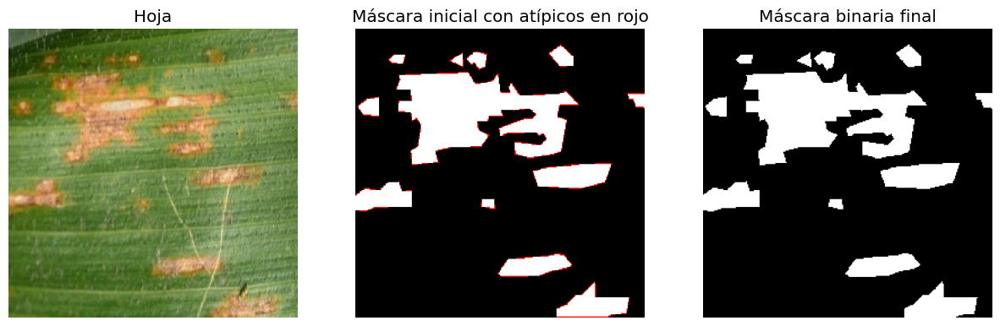

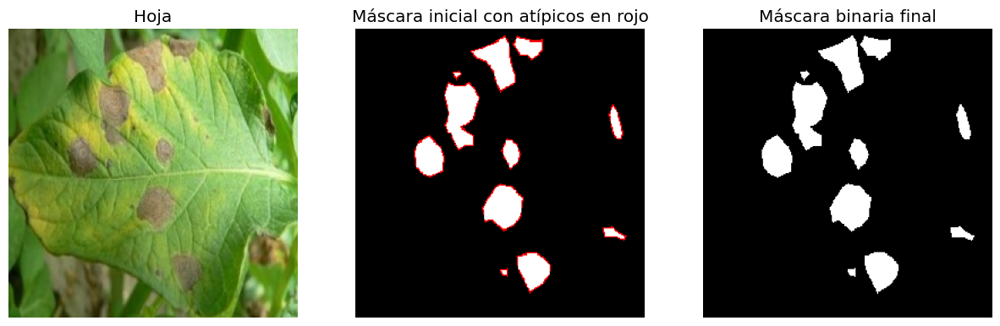

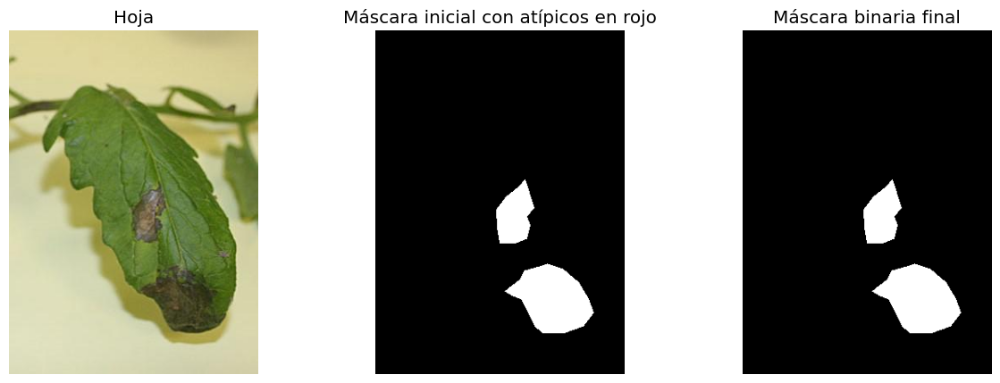

In [ ]:
comparativa_mascaras(3)

Ahora vamos a visualizar lo mismo pero con las máscaras de las hojas segmentadas. Que estos se encuentran en el rango 0 y 255, donde $0$ será el valor binario "0" y $255$ será el valor binario "1".

Leaf mask values: 3 ([  0 254 255])


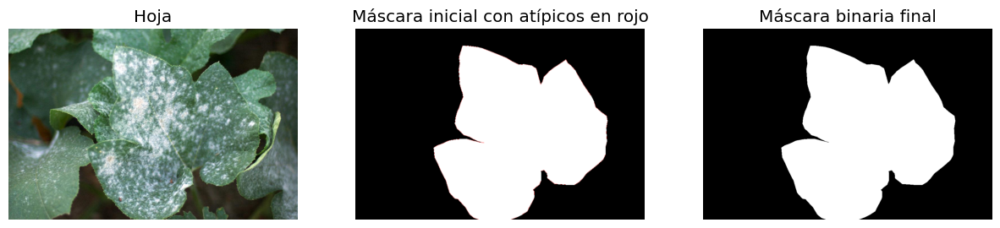

Leaf mask values: 4 ([  0   1   2 255])


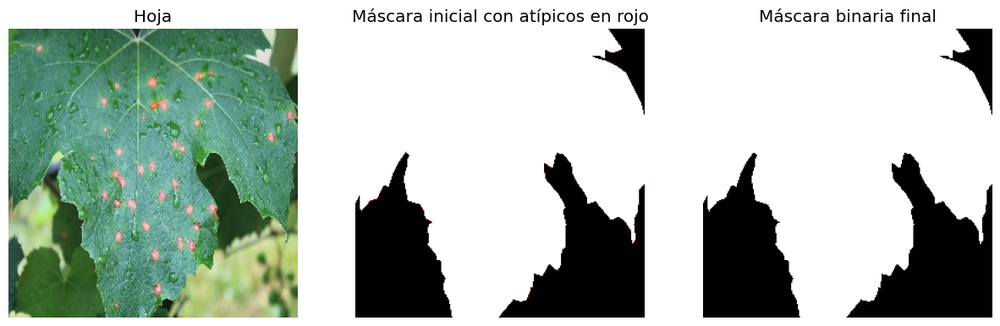

Leaf mask values: 225 ([  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48
  49  50  51  53  54  55  56  57  58  59  60  62  63  64  65  66  68  69  70  71  73  74  75  76  77  78  79  80  81  82  83  84  86  87  88  89  90  91  92  94  95  96  97  98  99 101 102 104 105
 106 108 109 110 111 112 113 114 115 116 118 119 120 121 122 124 125 127 128 130 131 132 133 134 135 136 137 138 140 141 143 144 145 146 147 149 150 152 153 155 156 157 159 160 161 162 163 165 166
 167 168 169 170 171 172 173 175 176 177 178 179 180 181 182 183 185 186 187 189 190 191 192 193 194 196 197 198 200 201 202 204 205 206 208 209 210 211 213 214 215 216 217 218 219 220 222 223 224
 225 226 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 244 245 246 247 248 249 250 251 252 253 254 255])


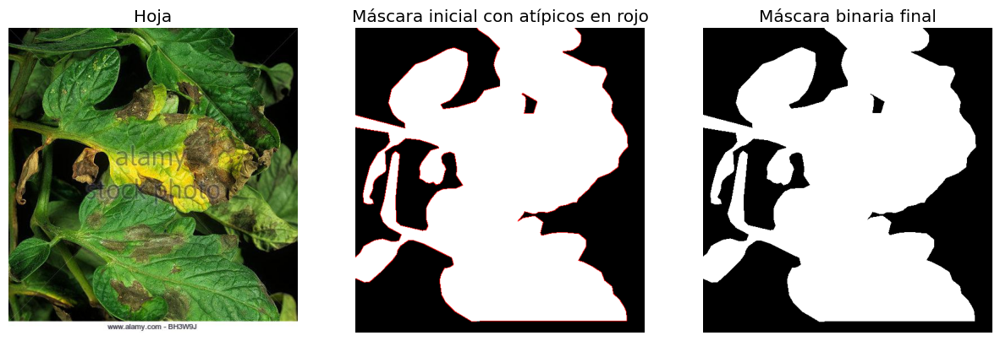

Leaf mask values: 207 ([  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48
  49  50  51  53  54  55  56  57  58  59  60  62  63  64  65  66  68  69  70  71  73  74  75  76  78  79  80  82  83  84  86  87  88  90  91  92  94  95  97  98  99 101 102 104 105 106 108 109 111
 112 114 115 116 118 119 121 122 124 125 127 128 130 131 132 134 135 137 138 140 141 143 144 146 147 149 150 152 153 155 156 157 159 160 162 163 165 166 168 169 170 172 173 175 176 178 179 180 182
 183 185 186 187 189 190 192 193 194 196 197 198 200 201 202 204 205 206 208 209 210 211 213 214 215 217 218 219 220 222 223 224 225 226 228 229 230 231 232 233 235 236 237 238 239 240 241 242 244
 245 246 247 248 249 250 251 252 253 254 255])


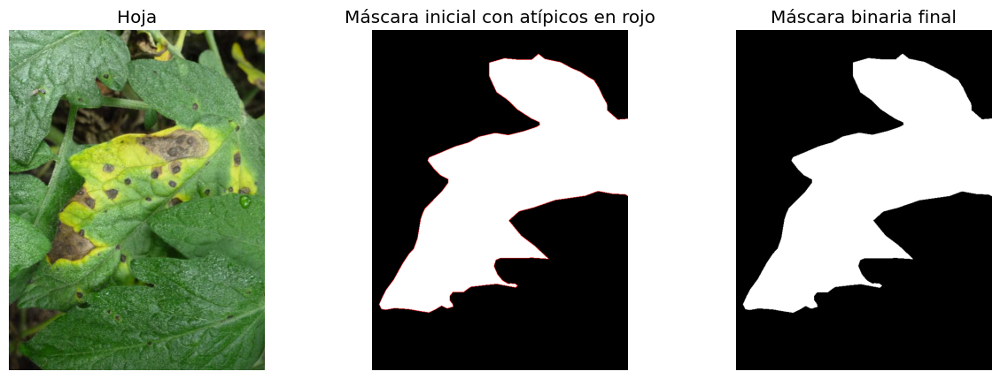

Leaf mask values: 4 ([  0   1   2 255])


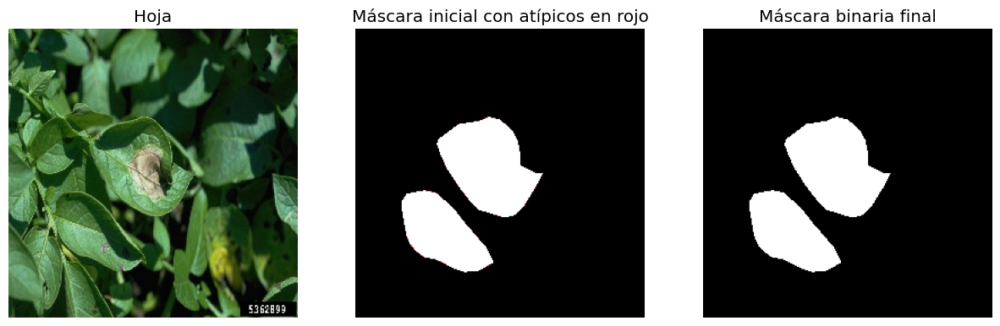

In [ ]:
comparativa_mascaras(leaf_mask=True)



---



# Dos formas de abordas el problema

## **Segmentación manual**

Como primera propuesta, intentaremos segmentar la hoja manualmente, empleando técnicas como detección de bordes o cambio a un espacio de colores alternativo.

### **Primera estrategia** : uso de un modelo de color alternativo a RGB

Podríamos comenzar visualizando los diferentes canales del espacio de colores RGB, con el objetivo de ver si realmente alguno de estos canales nos permite separar fácilmente la hoja del fondo de la imagen, aplicando técnicas como la umbralización, buscando que los píxeles de las hojas tengan niveles de intensidad similares entre sí y muy distintos con respecto a los del fondo.

In [ ]:
#Muestro los 3 canales RGB de la imagen
def mostrar_canales(HSV=False):
  for i in range(0,100,10):
    ruta_hoja = image_files[i]
    imagen= cv2.imread(ruta_hoja) #Cargamos imagen en formato BGR, por defecto
    imagen = cv2.cvtColor(imagen, cv2.COLOR_BGR2RGB)  # Convertir de BGR a RGB
    if(HSV):
        #Trabajamos en el espacio de colores HSV
        imagen = cv2.cvtColor(imagen, cv2.COLOR_BGR2HSV)
    #Separamos canales y visualizamos
    R,G,B=cv2.split(imagen)
    displayMI_ES([R,G,B],title=f"{ruta_hoja.name}")

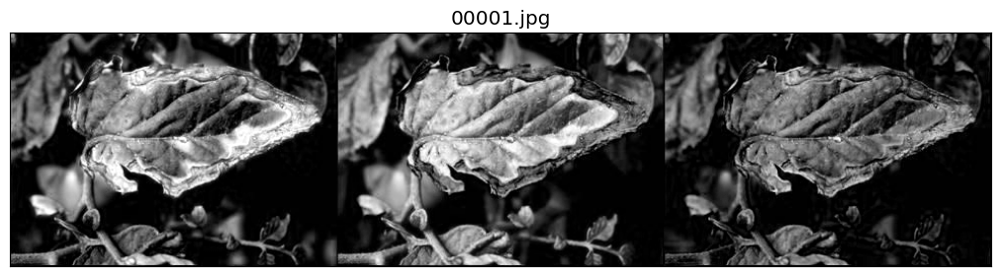

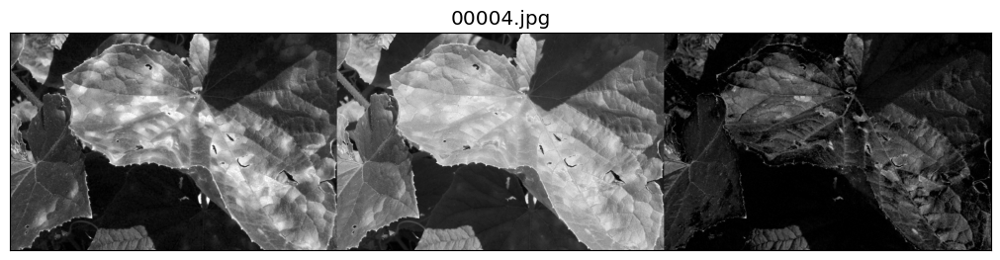

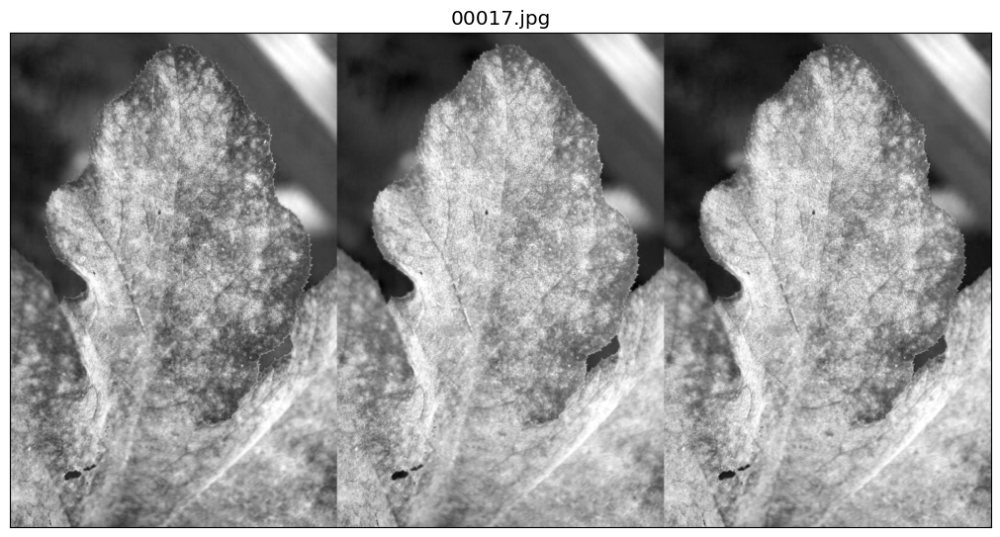

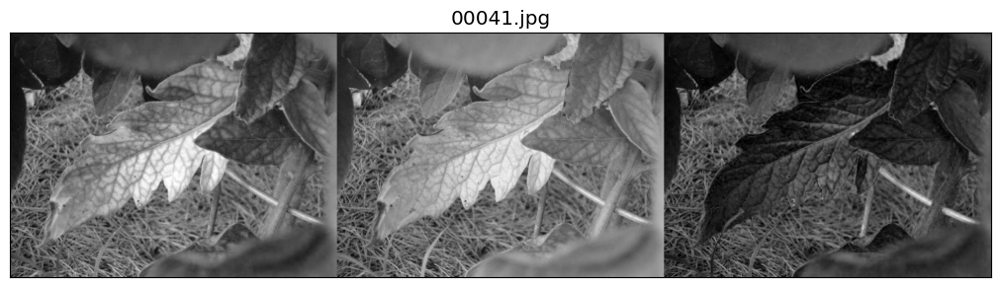

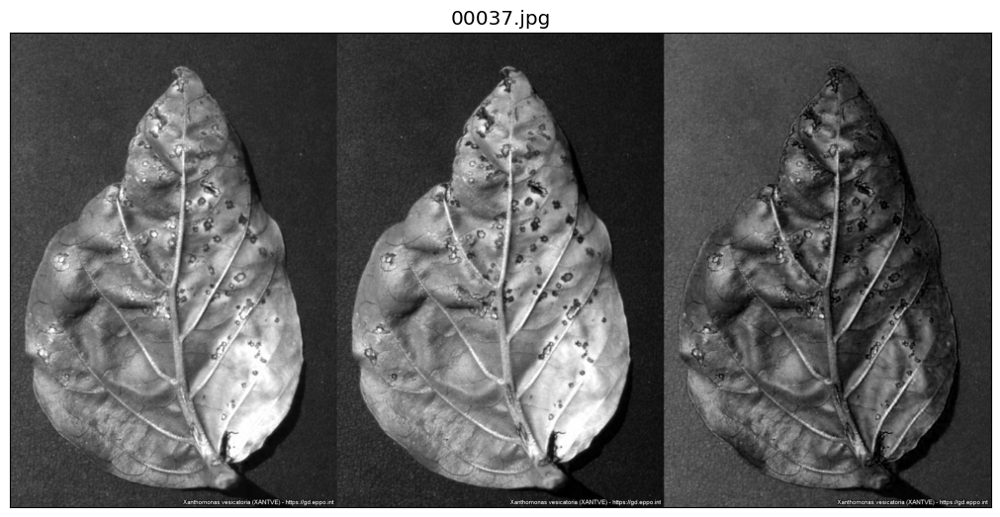

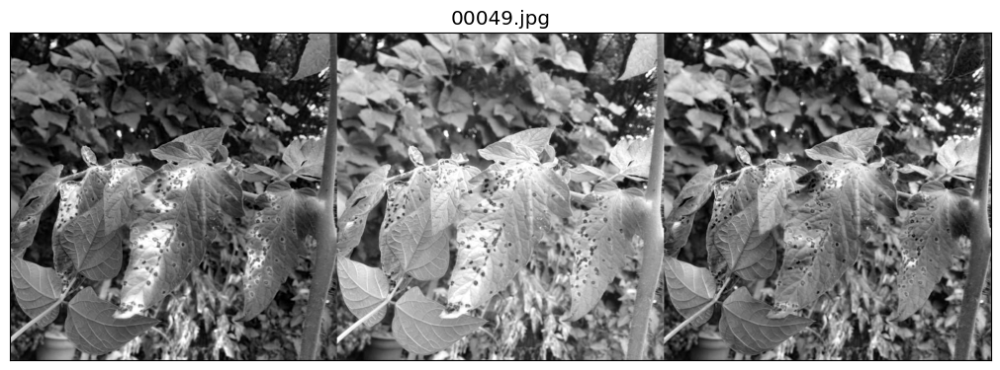

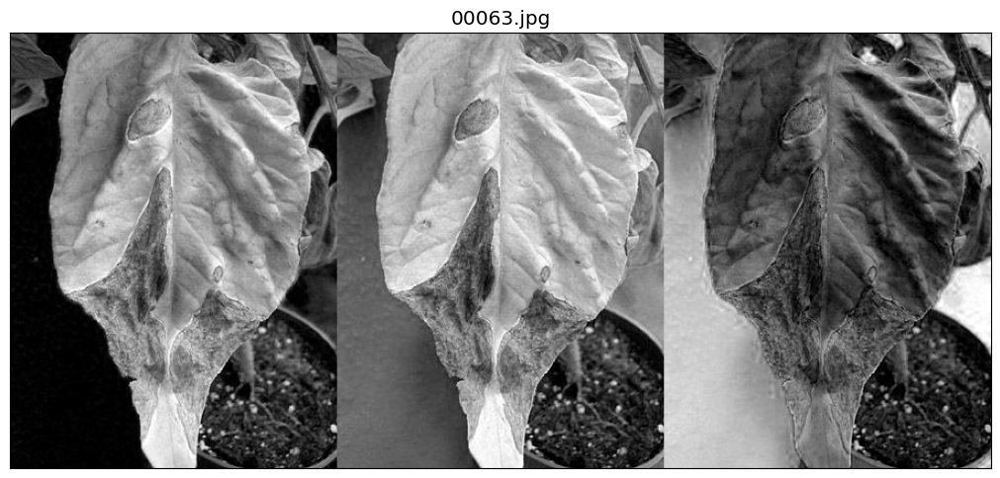

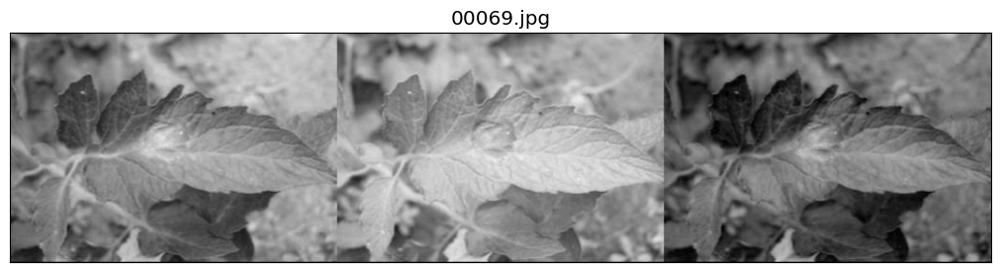

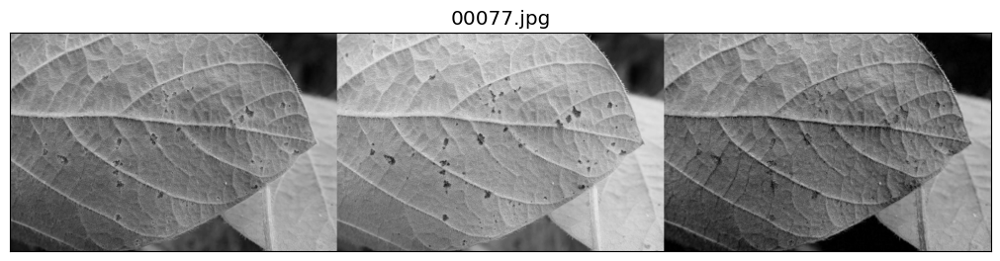

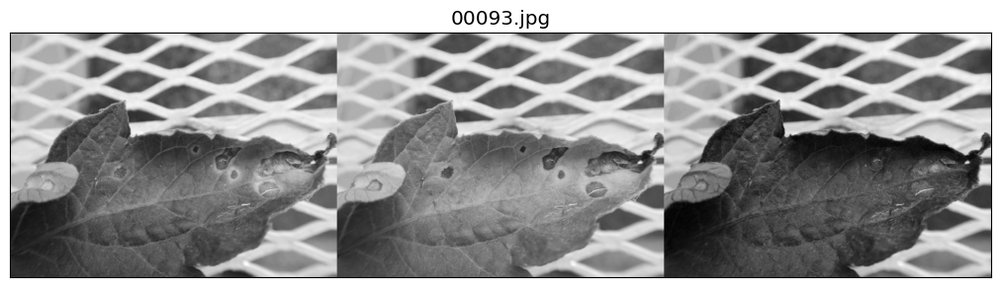

In [ ]:
mostrar_canales()

Sin embargo, tal y como se puede apreciar, no hay un canal fijo que nos permita distinguir fácilmente la hoja, independientemente de la imagen, resultando en ciertos casos incluso prácticamente imposible en cualquier canal que consideremos.

Optamos por hacer una conversión a otro modelo de color, **HSV**, con el mismo objetivo que antes : detectar algún canal ( ya sea H, S o V) que nos ofrezca visualmente una clara distinción entre los píxeles de la hoja y los del fondo.

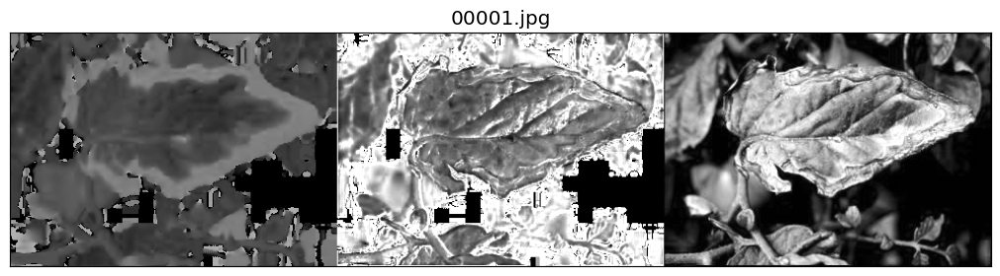

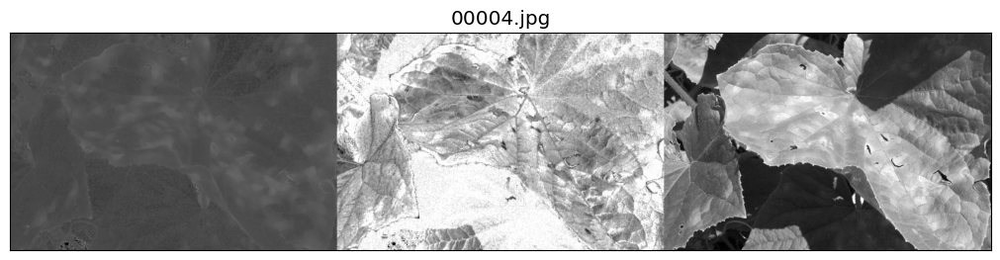

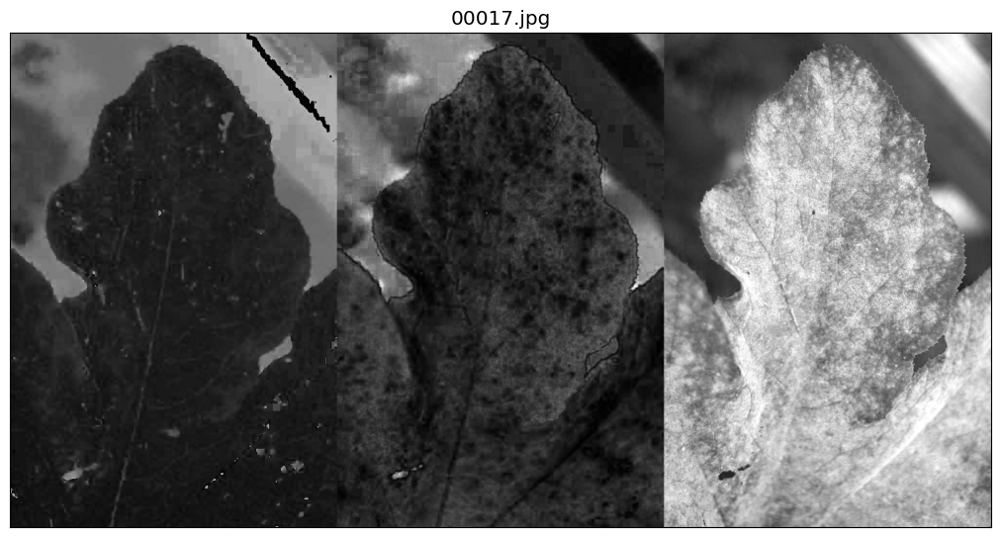

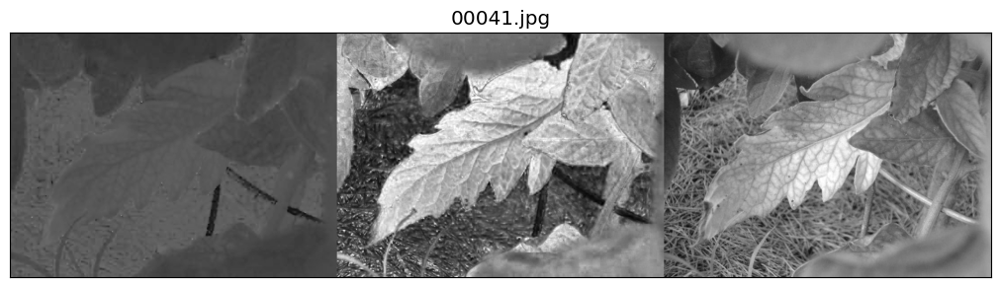

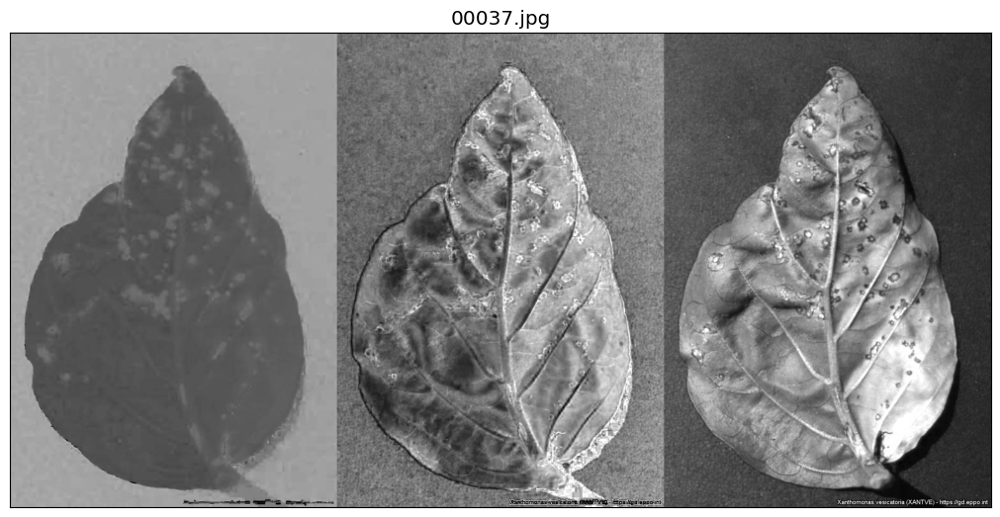

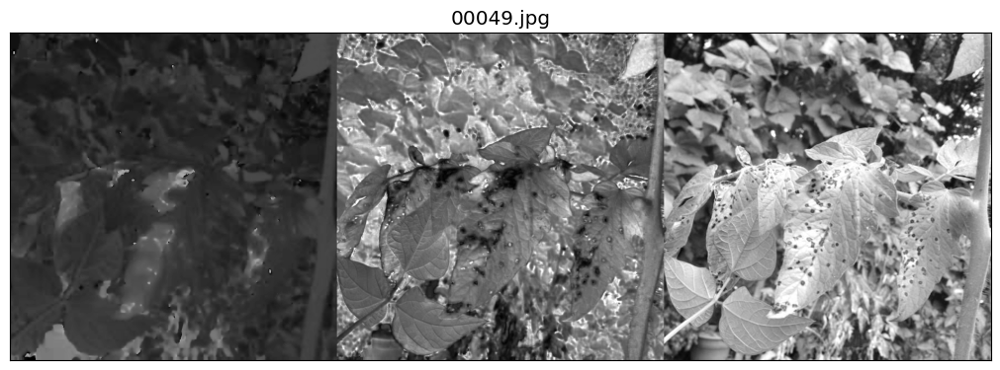

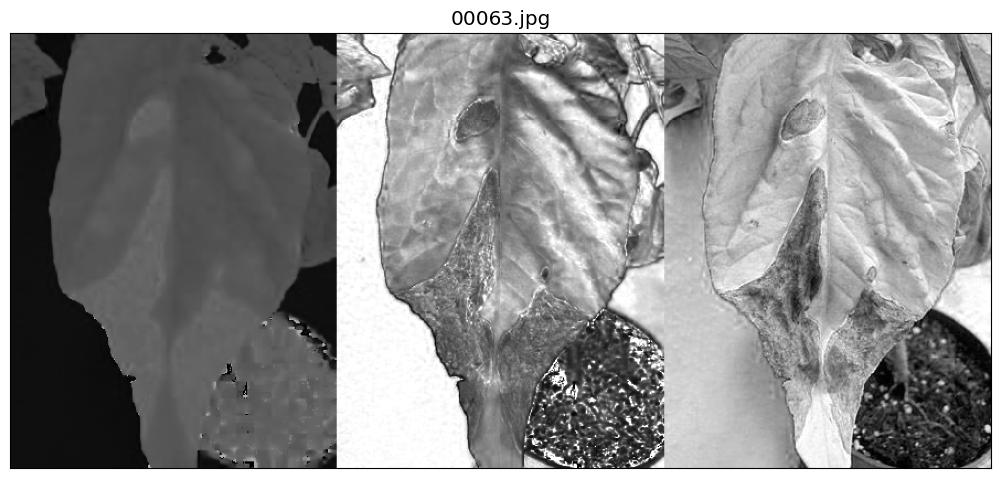

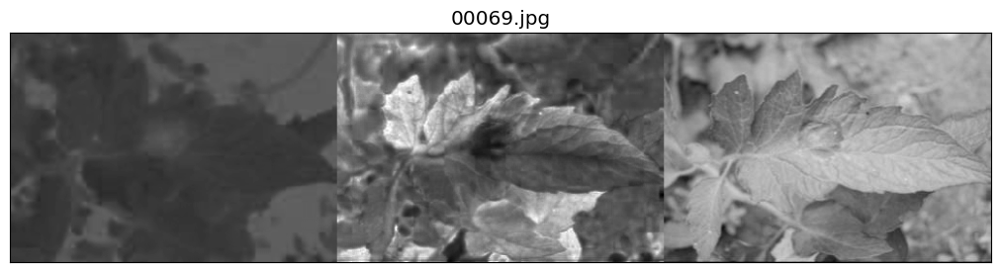

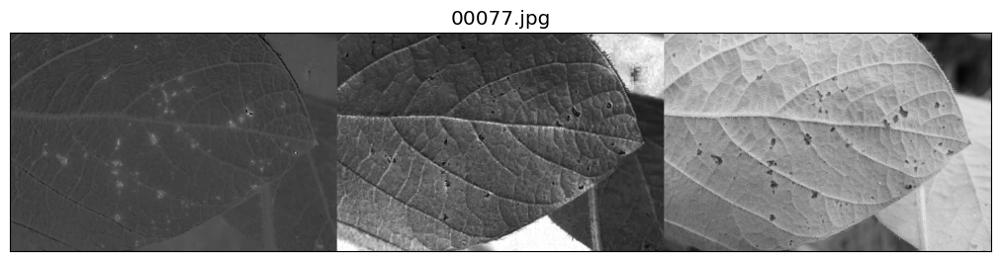

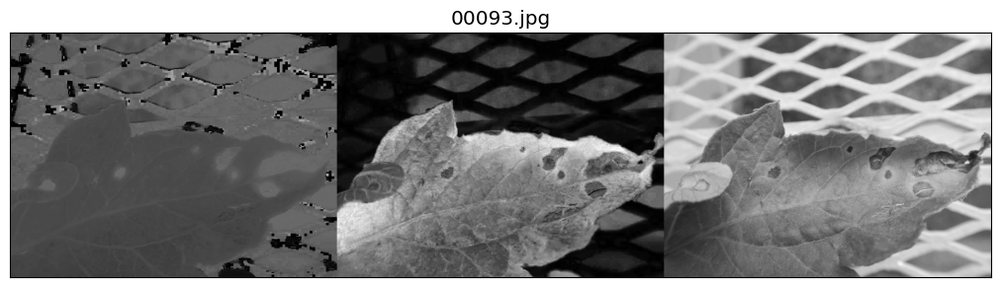

In [ ]:
mostrar_canales(HSV=True)

Como se puede observar, tampoco es fácil identificar un canal que logre visualizar con claridad la hoja con respecto al fondo. Para imágenes con un fondo simple, usando un color plano, el canal H si que nos permite, con claridad, separar la hoja del fondo. Sin embargo, cuando la imagen presenta un fondo más complejo, no ocurre lo mismo.

Por ende, este primer enfoque de comenzar buscando algún canal en el espacio de colores que nos permita fácilmente separar la hoja del fondo no nos sirve.

### **Segunda estrategia** : detección de contornos

A modo de ejemplo, y para comprobar el resultado que obtendríamos para una de las hojas, tomaremos una de ellas, comenzando por suavizarla. Para realizar el suavizado, se ha optado por usar un filtro normalizado, ponderando todos los píxeles vecinos por igual.

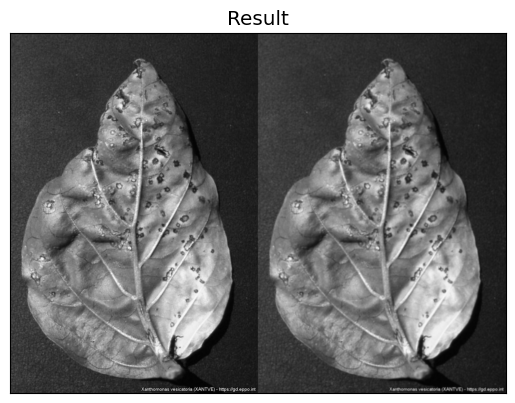

In [ ]:
# Aplicar suavizado con Gaussian Blur
imagen_inicial = cv2.imread(image_files[37])

imagen = cv2.cvtColor(imagen_inicial, cv2.COLOR_BGR2GRAY)
imagen_suavizada = cv2.blur(imagen, (5, 5))
displayMI_ES([imagen,imagen_suavizada],factor=1)

La imagen previa muestra la imagen original y la imagen suavizada empleando el kernel indicado.

A posteriori, empleamos el **detector de bordes Canny**. El suavizado realizado previamente nos permitirá reducir el ruido presente en la imagen, evitando la detección incorrecta de bordes.

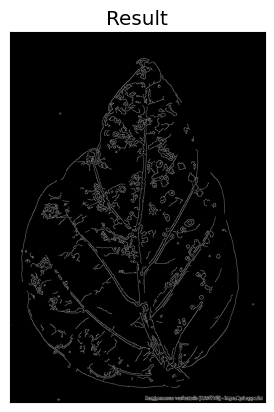

In [ ]:
# Aplicar el detector de bordes Canny
umbral_bajo = 10
umbral_alto = 100
bordes_canny = cv2.Canny(imagen_suavizada, umbral_bajo, umbral_alto)
displayIm(bordes_canny,factor=1)

Ahora aplicaremos **Closing** para rellenar pequeños huecosque puedan estar presentes en las diferentes regiones blancas de la imagen obtenida, con el objetivo de que las regiones con fondo blanco detectadas en la imagen sean lo más clara posibles.

Para ello, usamos el método `cv2.morphologyEx` con los siguientes parámetros :
* `src` : imagen de trabajo
* `op` : tipo de operación morfológica a aplicar. En este caso, **Closing**
* `kernel` : define la vecindad sobre la que se aplicará la operación morfológica especificada, tal que su tamaño determinará el alcance del efecto a aplicar, es decir, los píxeles vecinos que se considerarán a la hora de aplicar la operación morfológica.

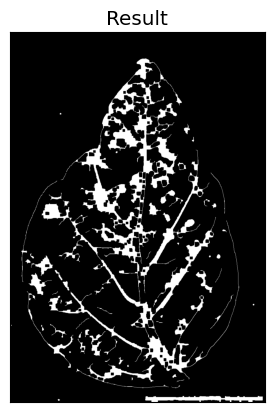

In [ ]:
kernel = np.ones((10,10)) #Ampliar el tamaño del kernel nos permitirá unir bordes distantes
closing=cv2.morphologyEx(bordes_canny, cv2.MORPH_CLOSE, kernel)
displayIm(closing,factor=1)

Finalmente aplicamos el método **findContours**, con el objetivo de localizar contornos en la imagen, es decir, objetos blancos situados en un fondo negro, y escogiendo el mayor de ellos, que en principio, y si los contornos se han definido correctamente, debería de corresponderse con la hoja.

Para este proceso, es necesario realizar todos los pasos realizados previamente, ya que `cv2.findContours()` tendrá una mayor precisión si trabaja sobre **imágenes binarias**. Por esta razón, se ha empleado el **detector de bordes Canny**, devolviendo una imagen binaria.

Se emplearán los siguientes parámetros:
* `cv2.RETR_EXTERNAL` : considerará sólo los contornos más externos, ignorando aquellos contornos interiores a él.
* `cv2.CHAIN_APPROX_SIMPLE` : determina cómo se almacenan los puntos de los contornos detectados. En este caso, para cada contorno considerado, se guardarán los vértices.

Para dibujar

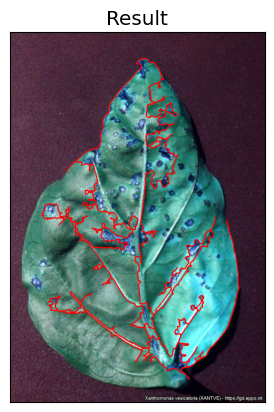

In [ ]:
#Detectamos los contornos presentes en la imagen (entre ellas, esperamos que esté incluida la hoja)
contornos, jerarquia = cv2.findContours(closing, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

#Calculamos el área de los contornos detectados, con el objetivo de tomar el de mayor área
lista_areas=[]
for i in range(len(contornos)):
  #Para cada contorno, tomamos el área de dicho contorno
  area = cv2.contourArea(contornos[i])
  lista_areas.append(area)

#Tomamos el contorno más grande, esperando que sea justamente la hoja presente en la imagen
area_max = max(lista_areas)
contornoMax = lista_areas.index(area_max)
#Dibujamos sobre la imagen original el contorno de mayor área, coloreando en rojo la curva que lo delimita
cv2.drawContours(imagen_inicial,contornos,contornoMax, color=(255,0,0),thickness=3)

# Mostrar la imagen en colores, delimitando el contorno más grande encontrado
displayIm(imagen_inicial, factor=1)

Para este ejemplo concreto, no se ha conseguido detectar el contorno que identifica la hoja en sí. Probaremos aún así con unas cuantas imágenes, para ver si realmente este procedimiento es útil de forma genérica.

In [ ]:
# rutas_hojas : lista de índices de imágenes de hojas a detectar en el rango [0,587]
def calcular_contorno_hoja(indices_hojas):
  for i in indices_hojas:
    imagen_inicial = cv2.imread(image_files[i])
    imagen = cv2.cvtColor(imagen_inicial, cv2.COLOR_BGR2GRAY)
    imagen_suavizada = cv2.blur(imagen, (5, 5))
    bordes_canny = cv2.Canny(imagen_suavizada, umbral_bajo, umbral_alto)
    kernel = np.ones((10,10))
    closing=cv2.morphologyEx(bordes_canny, cv2.MORPH_CLOSE, kernel)
    contornos, jerarquia = cv2.findContours(closing, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    lista_areas=[]

    for i in range(len(contornos)):
      #Para cada contorno, tomamos el área de dicho contorno
      area = cv2.contourArea(contornos[i])
      lista_areas.append(area)

    area_max = max(lista_areas)
    contornoMax = lista_areas.index(area_max)
    cv2.drawContours(imagen_inicial,contornos,contornoMax, color=(255,0,0),thickness=3)
    displayIm(imagen_inicial, factor=1, title=(Path(image_files[i]).stem))

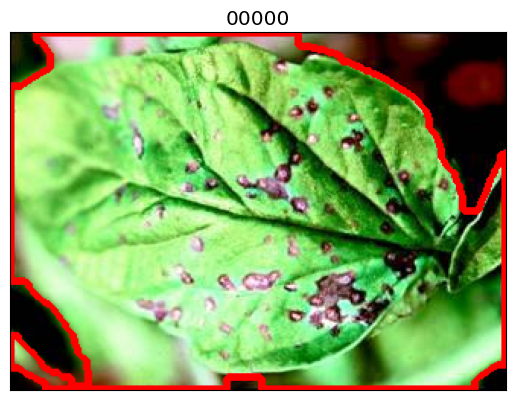

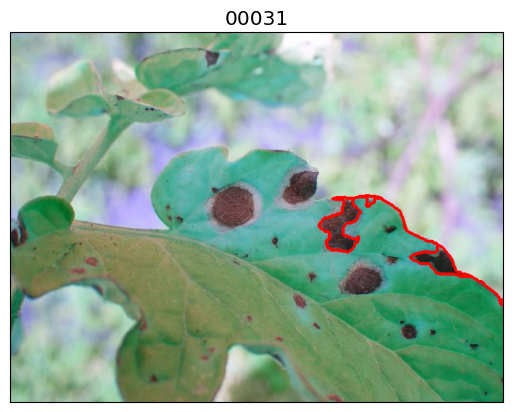

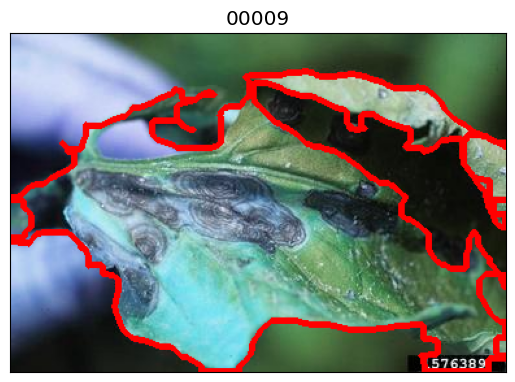

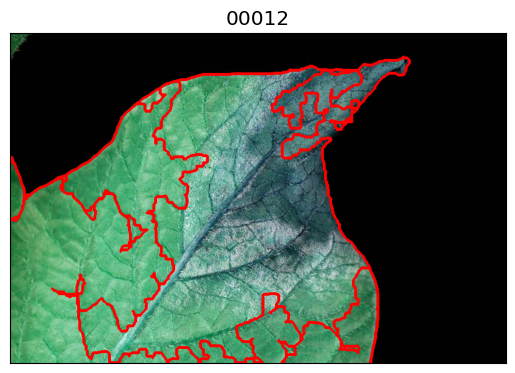

In [ ]:
calcular_contorno_hoja([0,5,12,10])

Debido a las enormes diferencias que presentan las imágenes del dataset entre sí, en cuanto a sombras, brillo y complejidad del fondo, resulta realmente complicado segmentar la hoja manualmente, tal y como hemos estado proponiendo hasta ahora. Por ende, lo más óptimo sería realizar una segmentación automática.

## **Segmentación automática**

### Métricas

Hemos optado por redefinir las métricas **Accuracy**, **Dice** y **Recall**, debido a que las proporcionadas por **FastAi** no funcionan correctamente teniendo en cuenta la salida de nuestro modelo, el cual devuelve logits, sin un rango predefinido.

**Dice** se utiliza para evaluar la precisión en tareas de segmentación binaria, favoreciendo a la clase minoritaria (enfermedad en este caso), ya que se enfoca en cómo el modelo predice correctamente los píxeles de esa clase. Para ello, mide la **intersección**, es decir, los píxeles que son correctamente predichos como enfermos tanto en la predicción como en la máscara real, y la **unión**, que incluye todos los píxeles clasificados como enfermos ya sea en la predicción o en la etiqueta real. A diferencia del **Accuracy**, que evalúa el porcentaje total de píxeles correctamente clasificados, **Dice** se enfoca específicamente en la clase objetivo, permitiendonos una mejor evaluación en escenarios donde la clase minoritaria es más relevante.

$$Dice = \frac{2 \cdot \text{Intersección}}{\text{Unión}}
$$

**Recall** mide la capacidad del modelo para identificar correctamente todas las zonas relevantes, en nuestra caso, las zonas enfermas de la hoja. Se calcula como la proporción de **verdaderos positivos (TP)**, es decir, las zonas correctamente identificadas como enfermas, frente a la suma de los **verdaderos positivos (TP)** y los **falsos negativos (FN)**, que son las zonas enfermas que el modelo no detectó. Un recall alto indica que el modelo está capturando la mayoría de las zonas enfermas.

$$ Recall = \frac{\text{True Positives (TP)}}{\text{True Positives (TP)} + \text{False Negatives (FN)}}
$$

In [ ]:
from fastai.metrics import Metric

class Dice(Metric):
    #def __init__(self, axis=1): self.axis = axis

    #Método encargada de resetear la métrica, para calcularla de nuevo
    def reset(self): self.inter,self.union = 0,0

    #Método encargado de calcular correctamente los parámetros que se emplearán en el método 'value' para obtener el valor de la métrica
    '''
    A partir del objeto learn, y una vez evaluado sobre validación usando learn.get_preds() (lo que inicializa learn.preds),
    se calcularán los valores de las variables 'inter' y 'union', necesarias posteriormente para obtener el valor de la métrica.
    '''
    def accumulate(self, learn):
        # Convertir los logits a probabilidades usando sigmoid
        pred = (learn.pred.sigmoid() > 0.5).float()  # Umbralización en 0.5 para binarizar
        targ = learn.y  # Las etiquetas reales (ya binarizadas)

        # Aplanar las predicciones y las etiquetas
        pred, targ = flatten_check(pred, targ)

        # Calcular la intersección y la unión
        self.inter += (pred * targ).float().sum().item()
        self.union += (pred + targ).float().sum().item()

    #Este método devolverá el valor que toma la métrica, usando los valores de los parámetors inter y union, asignados por el método previo
    @property
    def value(self):
        # Calcular el coeficiente de Dice
        return 2. * self.inter / self.union if self.union > 0 else None

In [ ]:
class Accuracy(Metric):
    "Accuracy metric for binary segmentation"
    def reset(self):
        self.correct, self.total = 0, 0

    def accumulate(self, learn):
        # Convertir los logits a probabilidades usando sigmoid
        pred = learn.pred.sigmoid()  # Aplicamos sigmoid a los logits
        pred = (pred > 0.5).float()   # Binarizamos las predicciones usando un umbral de 0.5

        targ = learn.y  # Las etiquetas reales (ya binarizadas en este caso). Contendrán únicamente dos flotantes: 0.0 y 1.0

        # Aplanar las predicciones y las etiquetas para que sean 1D
        pred, targ = flatten_check(pred, targ)

        # Calcular los píxeles correctos
        self.correct += (pred == targ).float().sum().item()
        self.total += targ.numel()  # Total de píxeles

    @property
    def value(self):
        # Calcular la exactitud como el porcentaje de píxeles correctamente clasificados
        return self.correct / self.total if self.total > 0 else None


In [ ]:
class Recall(Metric):
    "Recall metric for binary segmentation"
    def reset(self):
        self.tp, self.fn = 0, 0

    def accumulate(self, learn):
        # Convertir los logits a probabilidades usando sigmoid
        pred = learn.pred.sigmoid()  # Aplicamos sigmoid a los logits
        pred = (pred > 0.5).float()   # Binarizamos las predicciones usando un umbral de 0.5

        targ = learn.y  # Las etiquetas reales (ya binarizadas en este caso). Contendrán únicamente dos flotantes: 0.0 y 1.0

        # Aplanar las predicciones y las etiquetas para que sean 1D
        pred, targ = flatten_check(pred, targ)

        # Calcular los verdaderos positivos (TP) y los falsos negativos (FN)
        self.tp += (pred * targ).sum().item()  # Verdaderos positivos
        self.fn += ((1 - pred) * targ).sum().item()  # Falsos negativos

    @property
    def value(self):
        # Calcular el recall como la razón entre TP y (TP + FN)
        return self.tp / (self.tp + self.fn) if (self.tp + self.fn) > 0 else None


### **División de los datos**

Creamos las carpetas para `train` y `test`, para así poder trabajar correctamente usando Datablocks.

In [ ]:
train_images_path = Path(base_path_data) / "train"
test_images_path = Path(base_path_data) / "test"

In [ ]:
train_images_path.mkdir(parents=True, exist_ok=True)
test_images_path.mkdir(parents=True, exist_ok=True)

In [ ]:
if not any(train_images_path.iterdir()) and not any(test_images_path.iterdir()):
    # Obtener los archivos de imágenes
    images_files = list(images_path.glob("*"))

    # Mezclar los archivos y dividir 90% para train, 10% para test
    random.shuffle(images_files)
    split_index = int(len(images_files)*0.9)
    train_data = images_files[:split_index]
    test_data = images_files[split_index:]

    # Función para copiar las imágenes
    def copy_files(data, images_dest):
        for image_file in data:
            # Copiar la imagen
            shutil.copy(str(image_file), str(images_dest / image_file.name))
        print(f"{len(data)} imágenes copiadas en la ruta: \n{images_dest}")

    # Copiar los archivos a las carpetas correspondientes
    copy_files(train_data, train_images_path)
    print("\n")
    copy_files(test_data, test_images_path)

else:
    print("Las carpetas de train y/o test ya contienen imágenes. No se realizaron copias.")

Las carpetas de train y/o test ya contienen imágenes. No se realizaron copias.


Ahora dividimos el conjunto de imágenes (eliminado aquellas empleadas para test) en dos :
  * Parte empleada para el entrenamiento, 80%
  * Parte empleada para validación, 20%

Para ello, definimos el `DataBlock` correspondiente.

* `MaskBlock` es un bloque de datos utilizado para tareas de segmentación, donde cada imagen tiene asociada una máscara que indica las áreas relevantes (en este caso, la zona de una hoja). Al usar **MaskBlock(codes=codes)**, se define un conjunto de clases específicas para los píxeles de la máscara, en nuestro caso, las clases son **'No hoja'** y **'Hoja'**. De esta forma indicamos que cada píxel en la máscara estará etiquetado como perteneciente a una de estas dos clases.

* Usaremos diferentes transformaciones sobre las hojas, como rotaciones, cambios de brillo... mediante el método `aug_transforms()`
* Usamos `RandomResizedCrop`, haciendo que el modelo visualice en cada época una parte concreta de la imagen. El recorte debe ocupar al menos un 40% de la imagen original, realizando adicionalmente un ajuste de las dimensiones, obteniendo recortes finales de tamaño 256x256.

Los dos últimos métodos comentados buscan ayudar al modelo para que se centre en entender el concepto básico de lo que es un objeto, y las diferentes formas mediante las que se puede representar en una imagen, pudiéndose situar en diferentes zonas de la imagen o incluso a diferentes tamaño.

In [ ]:
#Clases de los píxeles
codes = ['No hoja','Hoja']

In [ ]:
def get_leaf_mask(image_path):
    return get_mask(image_path, leaf_mask=True)

In [ ]:
# Crear un DataBlock con MaskBlock, pasando únicamente los datos de train
leaf_data_segmentation = DataBlock(
    blocks=(ImageBlock, MaskBlock(codes=codes)),
    get_items=get_image_files,
    splitter= RandomSplitter(valid_pct=0.2, seed=42),  # 20% de validación
    get_y=get_leaf_mask,  # Llamamos a la función get_mask pasando leaf_mask=True
    item_tfms=RandomResizedCrop(256, min_scale=0.4),
    batch_tfms=aug_transforms(size=256)
)

leaf_data_segmentation.summary(train_images_path)

Setting-up type transforms pipelines
Found 529 items
2 datasets of sizes 424,105
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_leaf_mask -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /content/drive/MyDrive/leaf_segmentation/leaf_data/data/train/00548.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=256x256
  Pipeline: get_leaf_mask -> PILBase.create
    starting from
      /content/drive/MyDrive/leaf_segmentation/leaf_data/data/train/00548.jpg
    applying get_leaf_mask gives
      [[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
    applying PILBase.create gives
      PILMask mode=L size=256x256

Final sample: (PILImage mode=RGB size=256x256, PILMask mode=L size=256x256)


Found 529 items
2 datasets of sizes 424,105
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_leaf_mask -> PILBase.create
Setting up after_item: Pipeline: Add

In [ ]:
gen = torch.Generator().manual_seed(42)
dls_leaf = leaf_data_segmentation.dataloaders(train_images_path, bs=16)
dls_leaf.train.sampler = RandomSampler(dls_leaf.train.dataset,generator=gen)

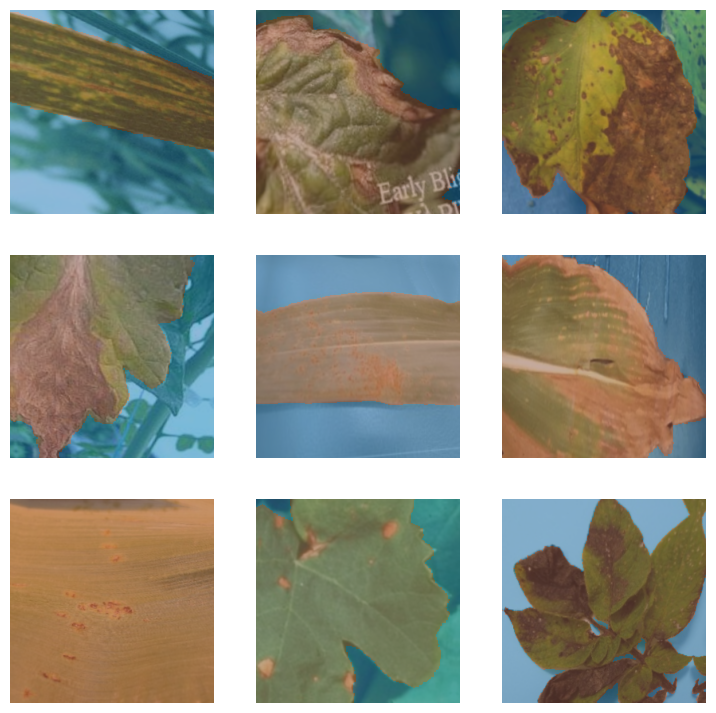

In [ ]:
dls_leaf.show_batch()

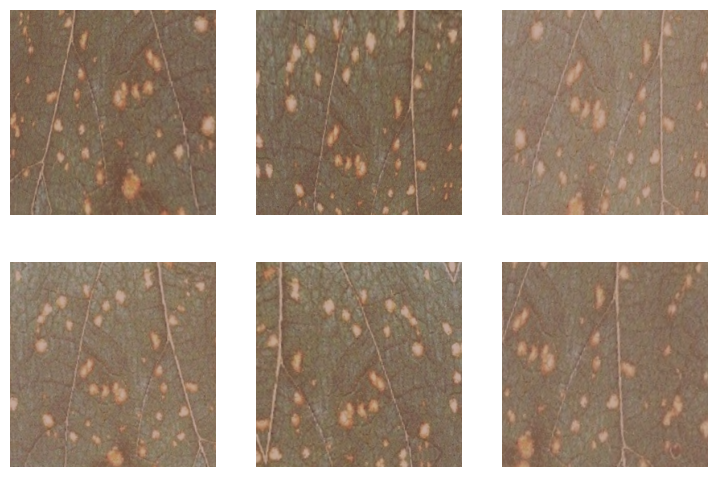

In [ ]:
dls_leaf.train.show_batch(max_n=6, nrows=2, unique=True)

### Entrenamiento

Como función de pérdida utilizaremos :

**`BCEWithLogitsLossFlat`** : tras obtener la salida del modelo, aplicará una **sigmoide**, obteniendo valores en [0,1] (probabilidades), y posteriormente, un **threshold** (por defecto, de 0.5), transformando la salida del modelo en una máscara de 0's y 1's, listo para ser comparado con la máscara real usando **CrossEntrophy**.
* **Salida del modelo** : El modelo devuelve un tensor de tamaño (batch_size, 1, 256, 256).

Por una parte, usamos la versión indicada de **BCEWithLogitsLoss**, que se encargará de aplicar previamente `.flatten()` sobre las predicciones y etiquetas,asegurando un mismo tamaño, para posteriormente calcular la pérdida.

In [ ]:
leaf_learn = unet_learner(
    dls_leaf,
    resnet34,
    loss_func=BCEWithLogitsLossFlat(),
    metrics=[Dice(),Accuracy(),Recall()],
    n_out=1  # La salida tenga solo 1 canal
)

leaf_learn.summary()

Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:00<00:00, 133MB/s]


DynamicUnet (Input shape: 16 x 3 x 256 x 256)
Layer (type)         Output Shape         Param #    Trainable 
                     16 x 64 x 128 x 128 
Conv2d                                    9408       False     
BatchNorm2d                               128        True      
ReLU                                                           
____________________________________________________________________________
                     16 x 64 x 64 x 64   
MaxPool2d                                                      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                                                           
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                     

/usr/local/lib/python3.10/dist-packages/fastai/learner.py:53: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state = torch.load(file, map_location=device, **torch_load_kwargs

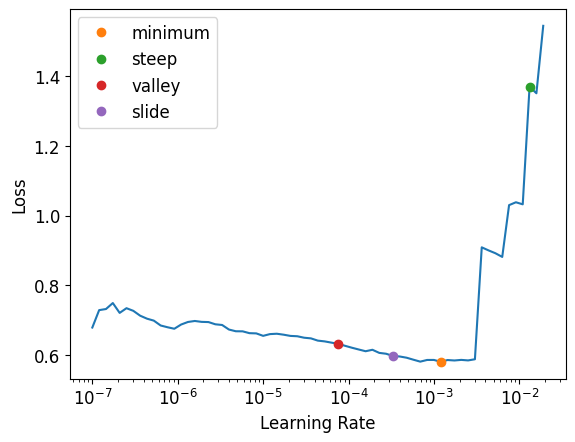

In [ ]:
lrs = leaf_learn.lr_find(suggest_funcs=(minimum, steep, valley, slide))

In [ ]:
# Entrenar el modelo con fine_tune
leaf_learn.fine_tune(20, base_lr=lrs.valley, cbs=[SaveModelCallback(), EarlyStoppingCallback(min_delta=0.01, patience=5)])

epoch,train_loss,valid_loss,dice,accuracy,recall,time
0,0.539675,0.419605,0.894220,0.852345,0.894306,02:05


Better model found at epoch 0 with valid_loss value: 0.4196045398712158.


epoch,train_loss,valid_loss,dice,accuracy,recall,time
0,0.383079,0.338235,0.901511,0.853689,0.959531,00:25
1,0.352778,0.284651,0.918370,0.882349,0.948342,00:24
2,0.327008,0.301881,0.913322,0.870332,0.978923,00:26
3,0.319197,0.245547,0.933334,0.904902,0.953908,00:27
4,0.294018,0.268439,0.923074,0.885478,0.984582,00:24
5,0.272264,0.216428,0.941014,0.915340,0.967662,00:25
6,0.250254,0.205493,0.944186,0.919474,0.976005,00:25
7,0.237715,0.201967,0.945581,0.922785,0.961269,00:26
8,0.238923,0.205216,0.940813,0.918759,0.925233,00:27
9,0.231445,0.202283,0.945579,0.921301,0.979712,00:25


Better model found at epoch 0 with valid_loss value: 0.33823490142822266.
Better model found at epoch 1 with valid_loss value: 0.28465133905410767.
Better model found at epoch 3 with valid_loss value: 0.24554716050624847.
Better model found at epoch 5 with valid_loss value: 0.2164275348186493.
Better model found at epoch 6 with valid_loss value: 0.2054927796125412.
Better model found at epoch 7 with valid_loss value: 0.20196692645549774.
Better model found at epoch 10 with valid_loss value: 0.18923833966255188.
Better model found at epoch 11 with valid_loss value: 0.17945876717567444.
Better model found at epoch 12 with valid_loss value: 0.17355404794216156.
Better model found at epoch 14 with valid_loss value: 0.16950151324272156.
Better model found at epoch 15 with valid_loss value: 0.16835618019104004.
Better model found at epoch 16 with valid_loss value: 0.16799825429916382.
No improvement since epoch 12: early stopping


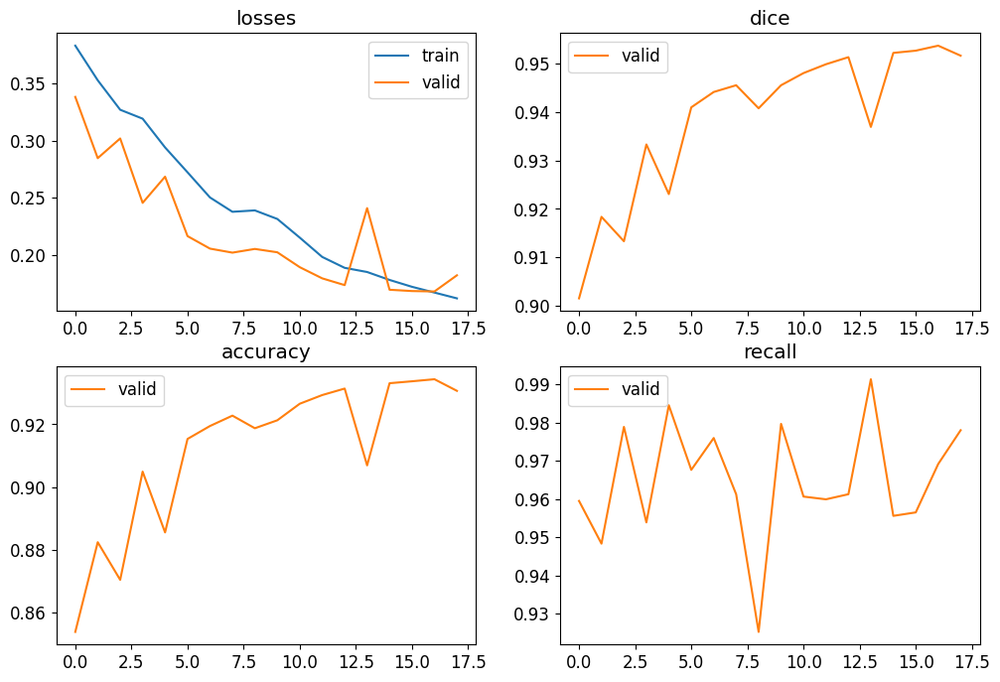

In [ ]:
# Mostar resultados
leaf_learn.recorder.plot_metrics()

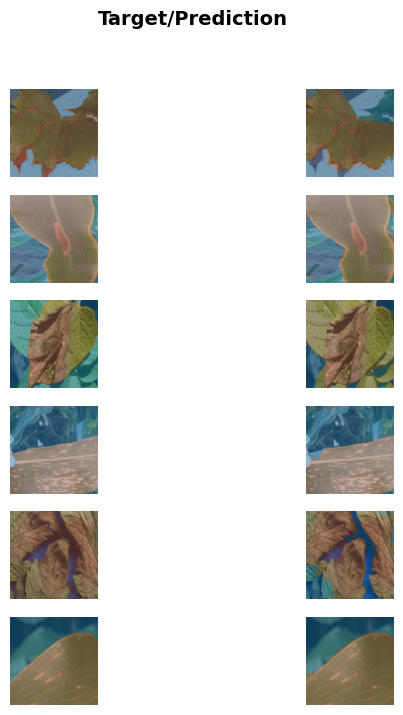

In [ ]:
leaf_learn.show_results(max_n=6, figsize=(7,8))

Exportamos el modelo entrenado

In [ ]:
export_path = '/content/drive/MyDrive/leaf_segmentation/leaf_segmentation_model.pkl'  # Ruta donde guardarás el modelo
leaf_learn.export(export_path)

In [ ]:
# Cargar el modelo exportado
leaf_loaded_model = load_learner("/content/drive/MyDrive/leaf_segmentation/leaf_segmentation_model.pkl")

## Primera forma de abordar el problema

Usar como imágenes las hojas segmentadas.

Tomamos la imagen, le hacemos un resize, se calcula la máscara y exportamos la imagen con la máscara calculada. Y hacemos el mismo procedimiento pero con la máscara de la zona infectada.

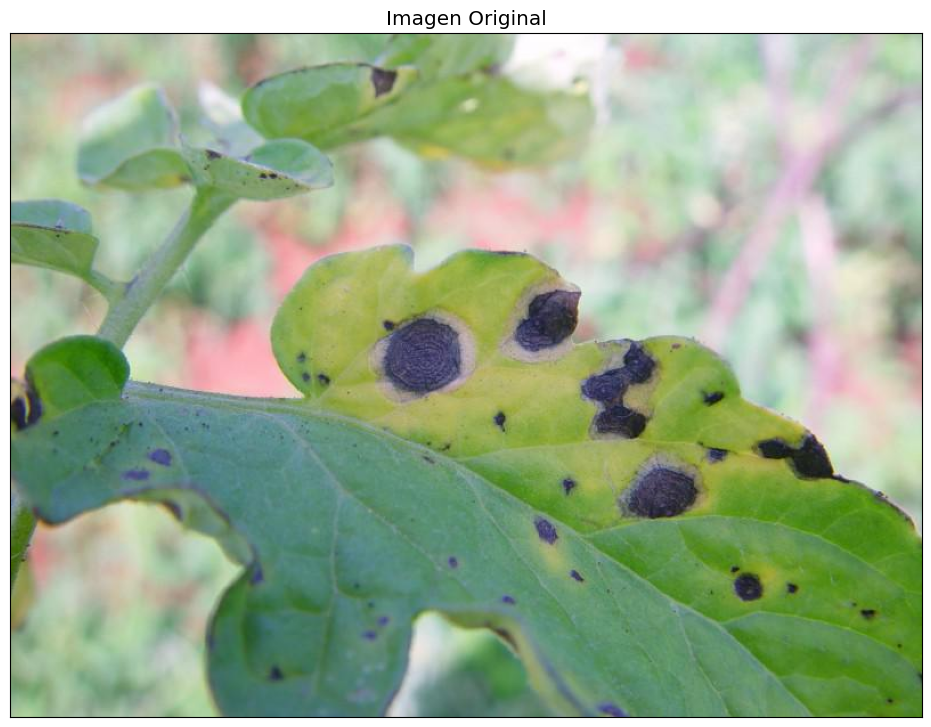

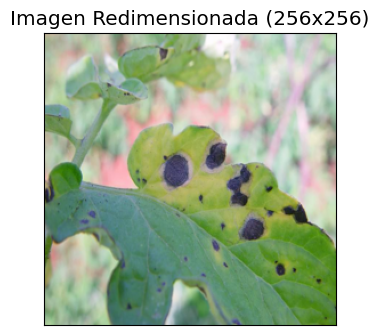

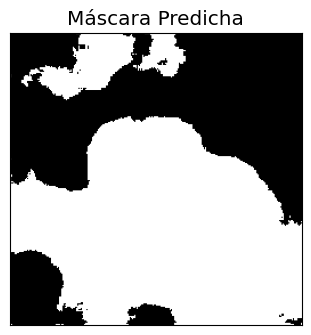

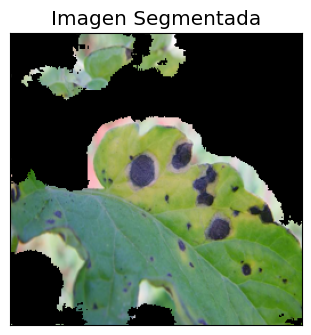

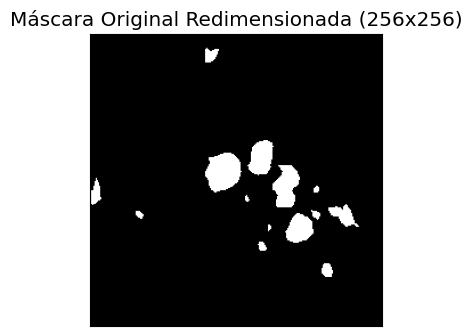

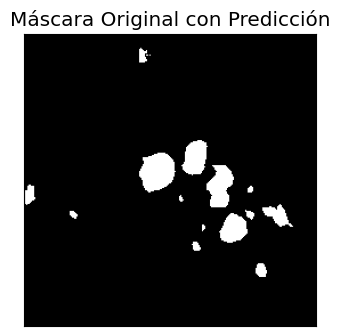

<Figure size 640x480 with 0 Axes>

In [ ]:
# Ruta de la imagen original
image_path = '/content/drive/MyDrive/leaf_segmentation/leaf_data/data/images/00005.jpg'

# Leer la imagen original con OpenCV y convertirla a RGB
image = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convertir de BGR a RGB

# Redimensionar la imagen a 256x256 con Pillow
original_image = Image.open(image_path)
resized_image = original_image.resize((256, 256))  # Cambiar tamaño a 256x256
resized_image_np = np.array(resized_image)  # Convertir a un array para OpenCV

# Guardar la imagen redimensionada temporalmente
temp_path = '/content/temp_resized_image.jpg'
resized_image.save(temp_path)

# Predicción con el modelo
pred_mask, _, _ = leaf_loaded_model.predict(temp_path)

# Convertir la máscara predicha a formato binario
pred_mask_np = np.array(pred_mask[0])  # Convertir la máscara a un array numpy
binary_mask = (pred_mask_np > 0.5).astype(np.uint8) * 255  # Umbralizar la máscara

# Aplicar la máscara a la imagen redimensionada
segmented_image = cv2.bitwise_and(resized_image_np, resized_image_np, mask=binary_mask)

# Trabajar con la máscara proporcionada
mask_path = '/content/drive/MyDrive/leaf_segmentation/leaf_data/data/image/00005.jpg'
mask = get_mask(Path(mask_path))  # Obtener la máscara original

# Redimensionar la máscara a 256x256
mask_resized = cv2.resize(mask, (256, 256), interpolation=cv2.INTER_NEAREST)

# Aplicar la máscara binaria predicha a la máscara original redimensionada
segmented_mask = cv2.bitwise_and(mask_resized, mask_resized, mask=binary_mask)

# Mostrar todas las imágenes juntas
plt.figure(figsize=(20, 10))

# Imagen original
plt.subplot(2, 3, 1)
displayIm(image_rgb, title="Imagen Original")

# Imagen redimensionada
plt.subplot(2, 3, 2)
displayIm(resized_image, title="Imagen Redimensionada (256x256)")

# Máscara predicha
plt.subplot(2, 3, 3)
displayIm(binary_mask, title="Máscara Predicha")

# Imagen segmentada
plt.subplot(2, 3, 4)
displayIm(segmented_image, title="Imagen Segmentada")

# Máscara original redimensionada
plt.subplot(2, 3, 5)
displayIm(mask_resized, title="Máscara Original Redimensionada (256x256)")

# Máscara segmentada
plt.subplot(2, 3, 6)
displayIm(segmented_mask, title="Máscara Original con Predicción")

plt.tight_layout()
plt.show()


Crear las imágenes, junto a sus respectivos directorios.

In [ ]:
# Ruta donde deseas crear la carpeta
folder_images_path = '/content/drive/MyDrive/leaf_segmentation/leaf_data/data/predictions_images'
folder_infected_mask_path = '/content/drive/MyDrive/leaf_segmentation/leaf_data/data/predictions_masks'

# Crear la carpeta si no existe
os.makedirs(folder_images_path, exist_ok=True)
os.makedirs(folder_infected_mask_path, exist_ok=True)

# Solo si no existen falta
print(f"Carpeta creada en: {folder_images_path}")
print(f"Carpeta creada en: {folder_infected_mask_path}")

for img_path in (get_image_files(images_path)):
  # Redimensionar la imagen a 256x256 con Pillow
  img_path = Path(img_path)
  original_image = Image.open(img_path)
  #print(type(original_image))
  resized_image = original_image.resize((256, 256))  # Cambiar tamaño a 256x256
  resized_image_np = np.array(resized_image)  # Convertir a un array para OpenCV

  # Guardar la imagen redimensionada temporalmente
  temp_path = '/content/temp_resized_image.jpg'
  resized_image.save(temp_path)

  # Predicción con el modelo
  pred_mask, _, _ = leaf_loaded_model.predict(temp_path)

  # Convertir la máscara predicha a formato binario
  pred_mask_np = np.array(pred_mask[0])  # Convertir la máscara a un array numpy
  binary_mask = (pred_mask_np > 0.5).astype(np.uint8) * 255  # Umbralizar la máscara

  # Aplicar la máscara a la imagen redimensionada
  segmented_image = cv2.bitwise_and(resized_image_np, resized_image_np, mask=binary_mask)

  mask = get_mask(Path(img_path))  # Obtener la máscara original

  # Redimensionar la máscara a 256x256
  mask_resized = cv2.resize(mask, (256, 256), interpolation=cv2.INTER_NEAREST)

  # Aplicar la máscara binaria predicha a la máscara original redimensionada
  segmented_mask = cv2.bitwise_and(mask_resized, mask_resized, mask=binary_mask)

  # Crear nombres de archivo con extensión
  image_filename = os.path.join(folder_images_path, f"{img_path.stem}.png")
  mask_filename = os.path.join(folder_infected_mask_path, f"{img_path.stem}.png")

  # Guardar las imágenes con cv2.imwrite
  cv2.imwrite(image_filename, segmented_image)
  cv2.imwrite(mask_filename, segmented_mask)


Carpeta creada en: /content/drive/MyDrive/leaf_segmentation/leaf_data/data/predictions_images
Carpeta creada en: /content/drive/MyDrive/leaf_segmentation/leaf_data/data/predictions_masks


In [ ]:
# Obtener archivos de imagen y máscaras
image_files = get_image_files(folder_images_path)
mask_files = get_image_files(folder_infected_mask_path)

print(f'Images : {len(image_files)} archivos')
print(f'Disease masks : {len(mask_files)} archivos')

Images : 588 archivos
Disease masks : 588 archivos


### **División de los datos**

In [ ]:
# Rutas de las carpetas de train y test
train_images_path = Path(base_path_data) / "train_2"
test_images_path = Path(base_path_data) / "test_2"
images_path = Path(base_path_data) / "predictions_images"
masks_path = Path(base_path_data) / "predictions_masks"

# Crear las carpetas de train2 y test2 si no existen
train_images_path.mkdir(parents=True, exist_ok=True)
test_images_path.mkdir(parents=True, exist_ok=True)

# Verificar si las carpetas están vacías
if not any(train_images_path.iterdir()) and not any(test_images_path.iterdir()):
    # Obtener los archivos de imágenes
    images_files = list(images_path.glob("*"))

    # Mezclar los archivos y dividir 90% para train, 10% para test
    random.shuffle(images_files)
    split_index = int(len(images_files) * 0.9)
    train_data = images_files[:split_index]
    test_data = images_files[split_index:]

    # Función para copiar las imágenes
    def copy_files(data, images_dest):
        for image_file in data:
            # Copiar la imagen
            shutil.copy(str(image_file), str(images_dest / image_file.name))
        print(f"{len(data)} imágenes copiadas en la ruta: \n{images_dest}")

    # Copiar los archivos a las carpetas correspondientes
    copy_files(train_data, train_images_path)
    print("\n")
    copy_files(test_data, test_images_path)

else:
    print("Las carpetas de train y/o test ya contienen imágenes. No se realizaron copias.")

Las carpetas de train y/o test ya contienen imágenes. No se realizaron copias.


In [ ]:
masks_path = Path(base_path_data) / "predictions_masks"

In [ ]:
# Función para obtener la ruta de la máscara correspondiente
def get_mask_fn_2(image_path):
    return masks_path / f"{image_path.stem}.png"

In [ ]:
get_mask_fn_2(Path("/content/drive/MyDrive/leaf_segmentation/leaf_data/data/predictions_images/00005.png"))

Path('/content/drive/MyDrive/leaf_segmentation/leaf_data/data/predictions_masks/00005.png')

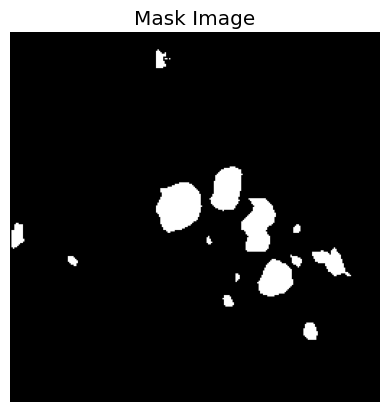

In [ ]:
def get_mask2(image_path):
    # masks_path should point to the directory containing the disease masks
    mascara = masks_path / f"{image_path.stem}.png"
    mascara = cv2.imread(str(mascara), cv2.IMREAD_GRAYSCALE)
    return mascara

image_path = Path('/content/drive/MyDrive/leaf_segmentation/leaf_data/data/predictions_images/00005.png')
mask = get_mask2(image_path)

# Display the image (mask)
plt.imshow(mask, cmap='gray')
plt.title('Mask Image')
plt.axis('off')  # Desactiva los ejes
plt.show()

Creamos el DataBlock. Donde las clases objetivos serán **'No infectado'** e **'infectado'**.

In [ ]:
#Clases de los píxeles
codes = ['No Infectado','Infectado']

In [ ]:
# Crear un DataBlock con MaskBlock, pasando únicamente los datos de train
leaf_data = DataBlock(
    blocks=(ImageBlock, MaskBlock(codes=codes)),
    get_items=get_image_files,
    splitter= RandomSplitter(valid_pct=0.2, seed=42),  # 20% de validación
    get_y=get_mask2,  # Función para obtener la máscara binaria asociada, ya en formato PILMask
    item_tfms=RandomResizedCrop(256, min_scale=0.4),
    batch_tfms=aug_transforms(size=256) #Me aseguro que tras aplicar una transformacion, el tamaño de la imagen resultante sea 256x256
)

leaf_data.summary(train_images_path)

Setting-up type transforms pipelines
Found 529 items
2 datasets of sizes 424,105
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_mask2 -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /content/drive/MyDrive/leaf_segmentation/leaf_data/data/train_2/00082.png
    applying PILBase.create gives
      PILImage mode=RGB size=256x256
  Pipeline: get_mask2 -> PILBase.create
    starting from
      /content/drive/MyDrive/leaf_segmentation/leaf_data/data/train_2/00082.png
    applying get_mask2 gives
      [[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
    applying PILBase.create gives
      PILMask mode=L size=256x256

Final sample: (PILImage mode=RGB size=256x256, PILMask mode=L size=256x256)


Found 529 items
2 datasets of sizes 424,105
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_mask2 -> PILBase.create
Setting up after_item: Pipeline: AddMaskCodes ->

In [ ]:
gen = torch.Generator().manual_seed(42)
dls = leaf_data.dataloaders(train_images_path, bs=16)
dls.train.sampler = RandomSampler(dls.train.dataset,generator=gen)

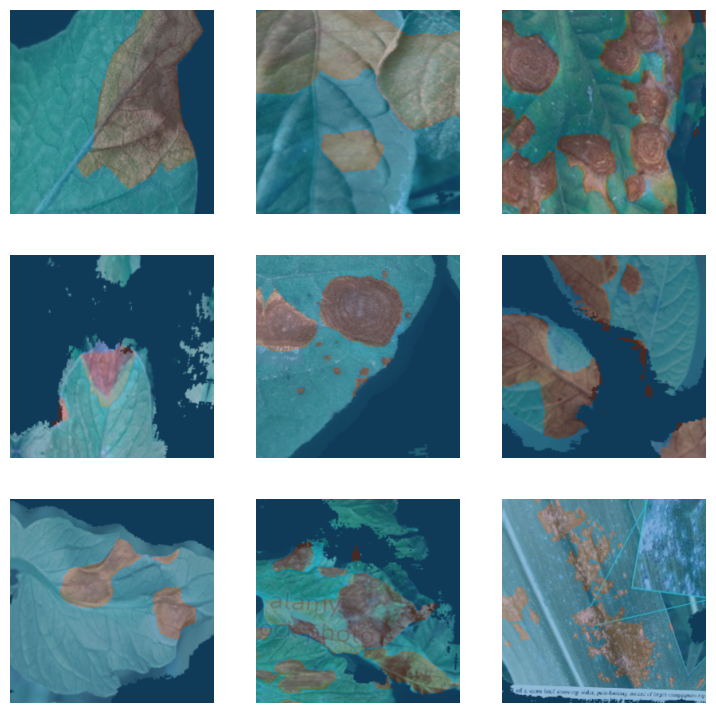

In [ ]:
dls.show_batch()

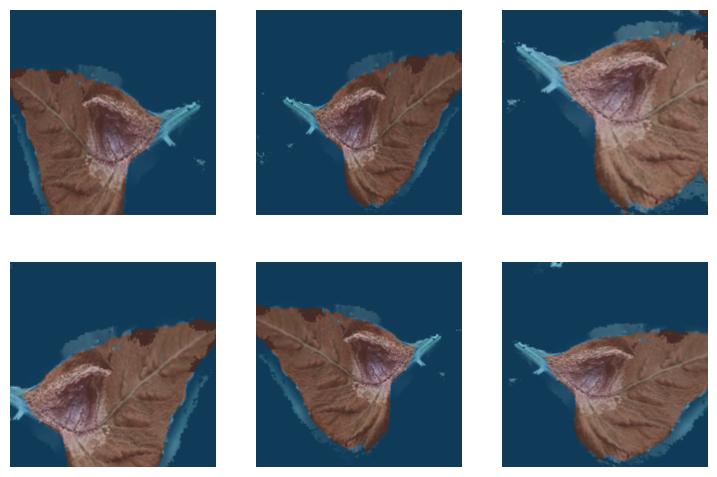

In [ ]:
dls.train.show_batch(max_n=6, nrows=2, unique=True)

### **Entrenamiento modelo 1**

Creamos el learn pero sin usar la métrica `Dice()`, ya que este tiene el mismo objetivo que la métrica `Recall()` evaluando el rendimiento del modelo a la hora de predecir los píxeles infectados correctamente.

In [ ]:
learn1 = unet_learner(
    dls,
    resnet34,
    loss_func=BCEWithLogitsLossFlat(),
    metrics=[Accuracy(),Recall()],
    n_out=1  # La salida tenga solo 1 canal
)

learn1.summary()

DynamicUnet (Input shape: 16 x 3 x 256 x 256)
Layer (type)         Output Shape         Param #    Trainable 
                     16 x 64 x 128 x 128 
Conv2d                                    9408       False     
BatchNorm2d                               128        True      
ReLU                                                           
____________________________________________________________________________
                     16 x 64 x 64 x 64   
MaxPool2d                                                      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                                                           
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                     

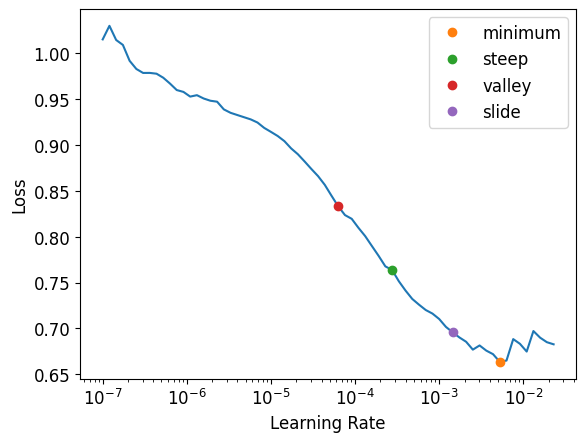

In [ ]:
lrs = learn1.lr_find(suggest_funcs=(minimum, steep, valley, slide))

Tomamos el mejor modelo tomando como referencia la métrica "Recall".

In [ ]:
# Entrenar el modelo con fine_tune
learn1.fine_tune(20, base_lr=lrs.valley, cbs=[SaveModelCallback(monitor='recall'), EarlyStoppingCallback(min_delta=0.01, patience=5)])

epoch,train_loss,valid_loss,accuracy,recall,time
0,0.684450,0.484253,0.806534,0.009004,00:21


Better model found at epoch 0 with recall value: 0.009004079577860386.


epoch,train_loss,valid_loss,accuracy,recall,time
0,0.477512,0.432421,0.809361,0.049713,00:21
1,0.449248,0.371035,0.823326,0.139139,00:23
2,0.423137,0.347538,0.855828,0.467383,00:22
3,0.370875,0.283823,0.880096,0.518033,00:22
4,0.331647,0.269782,0.884397,0.486644,00:22
5,0.307647,0.251957,0.892702,0.593816,00:22
6,0.283941,0.260090,0.891550,0.535983,00:22
7,0.268732,0.256631,0.894616,0.551077,00:22
8,0.267808,0.266914,0.887454,0.471356,00:21
9,0.253630,0.242388,0.899085,0.601331,00:22


Better model found at epoch 0 with recall value: 0.04971314029266136.
Better model found at epoch 1 with recall value: 0.13913923669839673.
Better model found at epoch 2 with recall value: 0.46738332990554654.
Better model found at epoch 3 with recall value: 0.5180334838489851.
Better model found at epoch 5 with recall value: 0.5938157099048712.
Better model found at epoch 9 with recall value: 0.601331004484773.
Better model found at epoch 10 with recall value: 0.6507532945123692.
Better model found at epoch 14 with recall value: 0.6570499341557975.
No improvement since epoch 10: early stopping


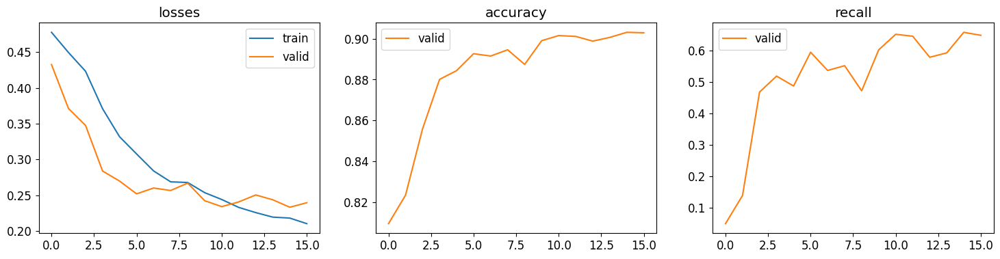

In [ ]:
# Mostar resultados
learn1.recorder.plot_metrics()

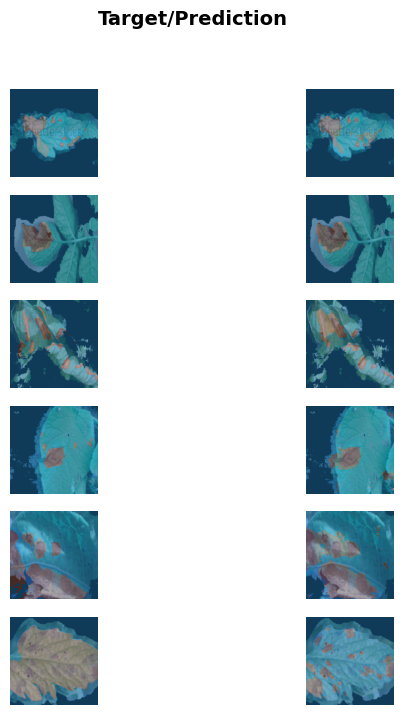

In [ ]:
learn1.show_results(max_n=6, figsize=(7,8))

Exportamos este modelo.

In [ ]:
export_path = '/content/drive/MyDrive/leaf_segmentation/leaf_disease_segmentation_model.pkl'  # Ruta donde guardarás el modelo
learn1.export(export_path)

In [ ]:
# Cargar el modelo exportado
loaded_disease_model = load_learner(export_path)

### **Entrenamiento modelo 2 (`BCEWithLogitsLossFlat` con pesos personalizados)**

In [ ]:
#Construimos una subclase de BCEWithLogitsLossFlat para modificar las dimensiones del tensor de predicciones
class CustomBCEWithLogitsLossFlat(BCEWithLogitsLossFlat):
    def __init__(self, *args, pos_weight=None, axis=-1, **kwargs):
        #Usamos el constructor de la clase padre, asignando el valor del parámetro pos_weight especificado
        super().__init__(*args, axis=axis, **kwargs)
        self.pos_weight = pos_weight

    #Propagación hacia delante: se invocará este método para obtener la pérdida asociada al lote
    def forward(self, input, target, **kwargs):
        # Eliminar la dimensión extra si es necesario
        if input.size(1) == 1:
            input = input.squeeze(1)  # (batch_size, 256, 256)

        # Se calcula la pérdida usando el siguiente módulo, pasando las predicciones y etiquetas (mismas dimensiones)
        bce_loss = torch.nn.functional.binary_cross_entropy_with_logits(
            input,
            target,
            weight=None,  # Puedes ajustar pesos específicos si es necesario
            pos_weight=self.pos_weight
        )
        return bce_loss

Es importante indicar que la función de pérdida `BCEWithLogitsLoss` tiende a clasificar nuevos píxeles a la clase mayoritaria, en este caso, como zona no afectada. Por ende, tal y como se puede suponer, no será adecuada cuando trabajamos con clases desequilibradas, como es el caso, ya que la clase que realmente nos interesa detectar (**zona afectada**) es la **minoritaria**, con respecto a la clase identificada como **zona no afectada**.

Por ende, se propone, como alternativa, cambiar la función de pérdida inicialmente empleada por `BCEWithLogitsLoss` por `CustomBCEWithLogitsLossFlat`.

Puede ocurrir que los resultados numéricos obtenidos con `BCEWithLogitsLoss` sean mucho mejores con respecto a la función de pérdida `CustomBCEWithLogitsLossFlat`. Sin embargo, es preferible optar por esta nueva ya que tiende a priorizar la clase minoritaria. Así, en este problema, penalizamos más clasificar un píxel infectado como no infectado, que clasificar un píxel no infectado como infectado.

In [ ]:
#Peso de la clase 'infectado' con respecto de la clase 'no infectado'. En la mayoría de las imágenes, las zonas no infectads suelen ocupar gran parte de la imagen, alrededor de un 70-75% con respecto a la zona infectada
pos_weight=pos_weight = torch.tensor(15.0) #Estimamos pos_weight = nº pixeles no infectados / nº pixeles infectados

In [ ]:
learn2 = unet_learner(
    dls,
    resnet34,
    loss_func=CustomBCEWithLogitsLossFlat(pos_weight=pos_weight),
    metrics=[Accuracy(),Recall()],
    n_out=1
)

learn2.summary()

DynamicUnet (Input shape: 16 x 3 x 256 x 256)
Layer (type)         Output Shape         Param #    Trainable 
                     16 x 64 x 128 x 128 
Conv2d                                    9408       False     
BatchNorm2d                               128        True      
ReLU                                                           
____________________________________________________________________________
                     16 x 64 x 64 x 64   
MaxPool2d                                                      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                                                           
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                     

/usr/local/lib/python3.10/dist-packages/fastai/learner.py:53: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state = torch.load(file, map_location=device, **torch_load_kwargs

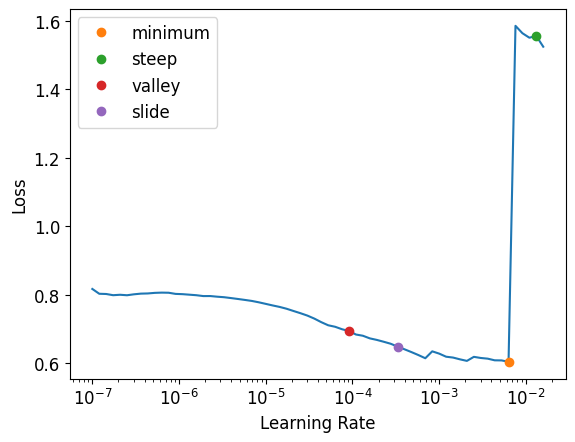

In [ ]:
lrs = learn2.lr_find(suggest_funcs=(minimum, steep, valley, slide))

In [ ]:
learn2.fine_tune(20, base_lr=lrs.valley, cbs=[SaveModelCallback(),EarlyStoppingCallback(min_delta=0.01, patience=5)])
#modelos.append(("Resnet34 con pesos", learn2))

epoch,train_loss,valid_loss,accuracy,recall,time
0,0.578709,0.415147,0.811763,0.012860,00:21


Better model found at epoch 0 with valid_loss value: 0.4151465892791748.


epoch,train_loss,valid_loss,accuracy,recall,time
0,0.410366,0.343216,0.838102,0.197065,00:21
1,0.363211,0.301079,0.870751,0.665653,00:22
2,0.335089,0.314894,0.866363,0.336992,00:21
3,0.330185,0.414324,0.823893,0.071889,00:22
4,0.325464,0.292530,0.880101,0.430434,00:21
5,0.302530,0.242092,0.898468,0.625921,00:22
6,0.281072,0.266510,0.889908,0.485609,00:22
7,0.269328,0.243339,0.897397,0.583661,00:22
8,0.258614,0.290131,0.883926,0.435727,00:22
9,0.252619,0.247001,0.901612,0.610493,00:21


Better model found at epoch 0 with valid_loss value: 0.34321579337120056.
Better model found at epoch 1 with valid_loss value: 0.3010791540145874.
Better model found at epoch 4 with valid_loss value: 0.2925297021865845.
Better model found at epoch 5 with valid_loss value: 0.24209243059158325.
Better model found at epoch 10 with valid_loss value: 0.2327120304107666.
No improvement since epoch 5: early stopping


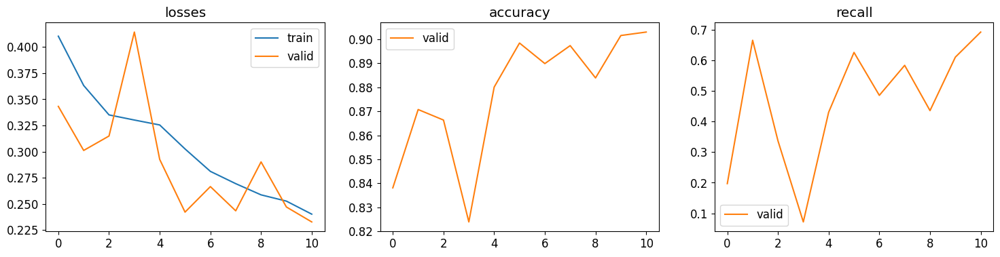

In [ ]:
# Mostar resultados
learn2.recorder.plot_metrics()

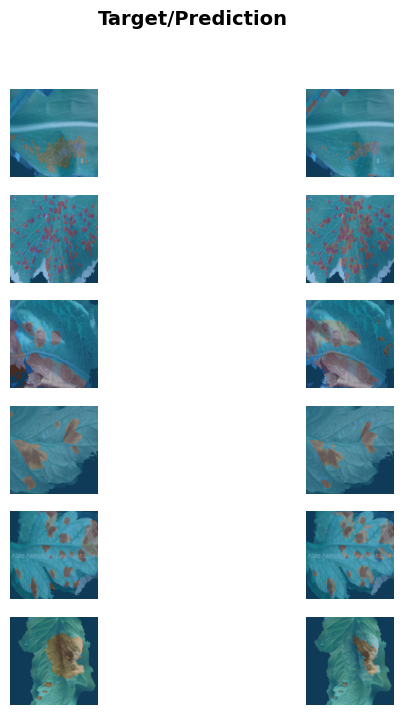

In [ ]:
learn2.show_results(max_n=6, figsize=(7,8))

## **Segunda forma de abordar el problema**

Segmentación zona infectada sin presegmentación.

Toma las imágenes de las hojas y sus respectivas máscaras. Además tambien tomamos las máscaras de las hojas en sí.

In [ ]:
# Crear las rutas para las imágenes y máscaras con data augmentation
base_path_data = "/content/drive/MyDrive/leaf_segmentation/leaf_data/data"
images_path = Path(base_path_data) / "images"
masks_path = Path(base_path_data) / "masks"
leaf_masks_path = Path(base_path_data) / "masks_leaf"

# Comprobar el acceso a las carpetas
def check_access(path):
  if os.path.exists(path) and os.path.isdir(path):
    print(f"Acceso correcto al directorio: {path}")
    return True
  print(f"Error: No se puede acceder a la carpeta: {path}")
  return False

# Verificar que ambas carpetas 'images' y 'mask' existen
if not check_access(images_path) or not check_access(masks_path) or not check_access(leaf_masks_path):
    raise SystemExit("No se pudo acceder a las carpetas necesarias. Verifica las rutas.")

Acceso correcto al directorio: /content/drive/MyDrive/leaf_segmentation/leaf_data/data/images
Acceso correcto al directorio: /content/drive/MyDrive/leaf_segmentation/leaf_data/data/masks
Acceso correcto al directorio: /content/drive/MyDrive/leaf_segmentation/leaf_data/data/masks_leaf


In [ ]:
# Rutas de las carpetas de train y test
train_images_path = Path(base_path_data) / "train"
test_images_path = Path(base_path_data) / "test"

In [ ]:
# Función para obtener la ruta de la máscara correspondiente o de la máscara de la hoja segmentada
def get_mask(image_path, leaf_mask=False):
  if leaf_mask:
    mascara = leaf_masks_path / f"{image_path.stem}.png"
    mascara = cv2.imread(mascara, cv2.IMREAD_GRAYSCALE)

    # Comprobar que haya fondo, ya que hay imágenes donde la hoja la ocupa entera
    if(len(np.unique(mascara)) > 1):
      min = np.min(mascara)
      mascara[mascara != min] = 1
      mascara[mascara == min] = 0

    # Máscara totalmente blanca
    else:
      return np.ones_like(mascara, dtype=np.uint8)

  else:
    mascara = masks_path / f"{image_path.stem}.png"
    mascara = cv2.imread(mascara, cv2.IMREAD_GRAYSCALE)
    mascara[mascara!=0]=1 #Ponemos a 1 todos aquellos píxeles con valores no nulos, obteniendo así una máscara binaria (0's y 1's)

  return mascara

Creamos el DataBlock para este nuevo problema.

In [ ]:
# Crear un DataBlock con MaskBlock, pasando únicamente los datos de train
leaf_data = DataBlock(
    blocks=(ImageBlock, MaskBlock(codes=codes)),
    get_items=get_image_files,
    splitter= RandomSplitter(valid_pct=0.2, seed=42),  # 20% de validación
    get_y=get_mask,  # Función para obtener la máscara binaria asociada, ya en formato PILMask
    item_tfms=RandomResizedCrop(256, min_scale=0.4),
    batch_tfms=aug_transforms(size=256) #Me aseguro que tras aplicar una transformacion, el tamaño de la imagen resultante sea 256x256
)

leaf_data.summary(train_images_path)

Setting-up type transforms pipelines
Found 529 items
2 datasets of sizes 424,105
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_mask -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /content/drive/MyDrive/leaf_segmentation/leaf_data/data/train/00548.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=256x256
  Pipeline: get_mask -> PILBase.create
    starting from
      /content/drive/MyDrive/leaf_segmentation/leaf_data/data/train/00548.jpg
    applying get_mask gives
      [[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
    applying PILBase.create gives
      PILMask mode=L size=256x256

Final sample: (PILImage mode=RGB size=256x256, PILMask mode=L size=256x256)


Found 529 items
2 datasets of sizes 424,105
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_mask -> PILBase.create
Setting up after_item: Pipeline: AddMaskCodes -> RandomR

In [ ]:
gen = torch.Generator().manual_seed(42)
dls = leaf_data.dataloaders(train_images_path, bs=16)
dls.train.sampler = RandomSampler(dls.train.dataset,generator=gen)

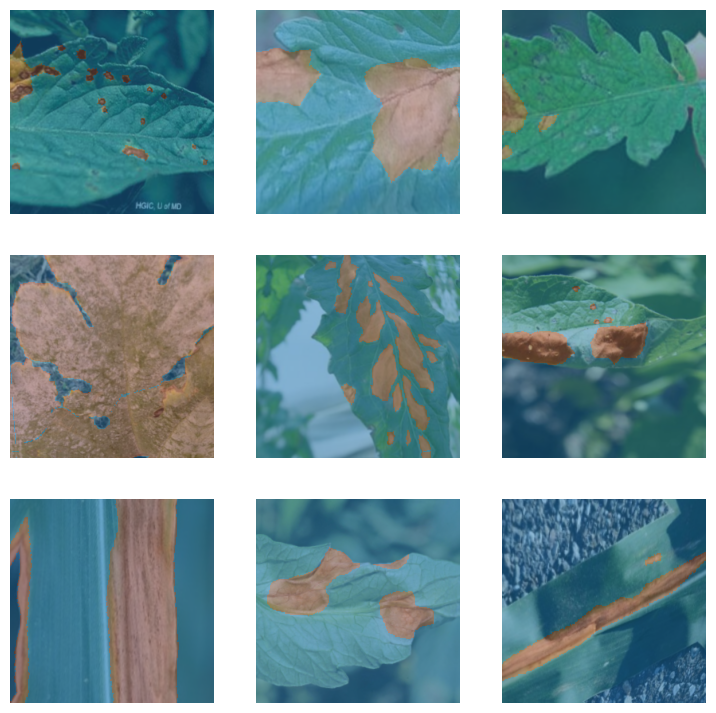

In [ ]:
dls.show_batch()

Visualizamos, a modo de ejemplo, una misma hoja con diferentes transformaciones aplicadas sobre ella

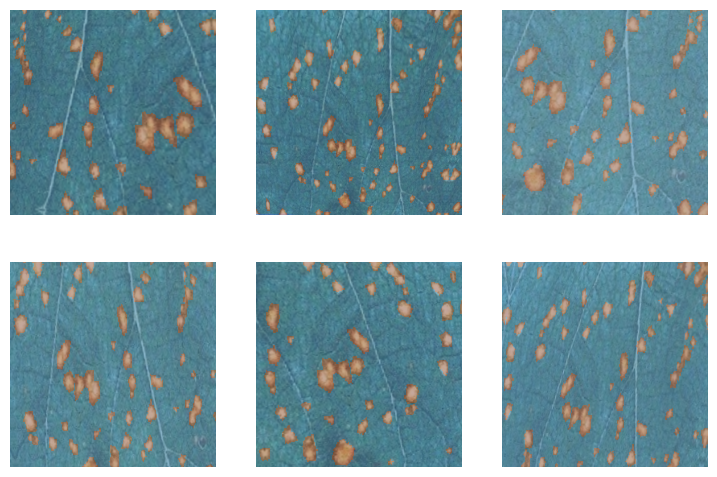

In [ ]:
dls.train.show_batch(max_n=6, nrows=2, unique=True)

### **Estrategias a seguir**

A la hora de entrenar nuestro modelo U-Net, se proponen las siguientes estrategias a seguir:
* **Funcion de pérdida** : se usarán dos variantes de `BCEWithLogitsLossFlat` :
  - Una primera versión donde ambas clases se tratan por igual.
  - Una segunda versión donde se ponderan ambas clases, asignando un mayor peso a la clase positiva a la hora de calcular la pérdida.
* **Backbones** : `ResNet34`y `XResNet34`
* **Entrenamiento** : ajuste fino usando un **modelo preentrenado**
* **Métricas** : `Dice`, `Accuracy` y `Recall`

### **Entrenamiento modelo 1**


In [ ]:
learn1 = unet_learner(
    dls,
    resnet34,
    loss_func=BCEWithLogitsLossFlat(),
    metrics=[Dice(),Accuracy(),Recall()],
    n_out=1  # La salida tenga solo 1 canal
)

learn1.summary()

DynamicUnet (Input shape: 16 x 3 x 256 x 256)
Layer (type)         Output Shape         Param #    Trainable 
                     16 x 64 x 128 x 128 
Conv2d                                    9408       False     
BatchNorm2d                               128        True      
ReLU                                                           
____________________________________________________________________________
                     16 x 64 x 64 x 64   
MaxPool2d                                                      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                                                           
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                     

/usr/local/lib/python3.10/dist-packages/fastai/learner.py:53: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state = torch.load(file, map_location=device, **torch_load_kwargs

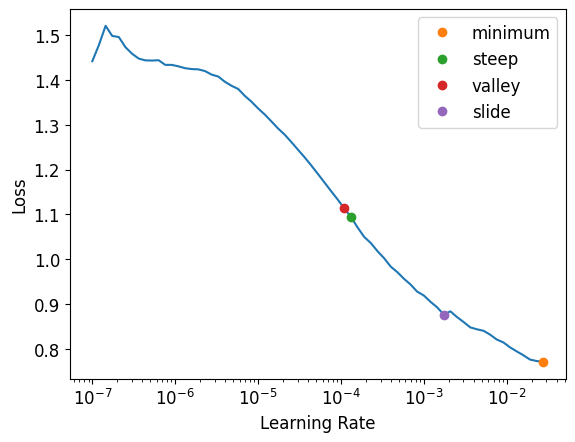

In [ ]:
lrs = learn1.lr_find(suggest_funcs=(minimum, steep, valley, slide))

In [ ]:
# Entrenar el modelo con fine_tune
learn1.fine_tune(20, base_lr=lrs.valley, cbs=[SaveModelCallback(monitor='recall'), EarlyStoppingCallback(min_delta=0.01, patience=5)])

epoch,train_loss,valid_loss,dice,accuracy,recall,time
0,0.734179,0.562354,0.360327,0.780206,0.311822,00:24


Better model found at epoch 0 with recall value: 0.3118224394157442.


epoch,train_loss,valid_loss,dice,accuracy,recall,time
0,0.446796,0.405061,0.140906,0.813305,0.077121,00:26
1,0.403099,0.320873,0.617410,0.867580,0.538205,00:24
2,0.372647,0.391960,0.650103,0.822960,0.828449,00:23
3,0.340776,0.275013,0.708939,0.888004,0.687036,00:25
4,0.314827,0.264945,0.720338,0.892426,0.697853,00:23
5,0.293050,0.263787,0.693879,0.893970,0.605303,00:24
6,0.284201,0.276075,0.708433,0.893232,0.653359,00:22
7,0.268388,0.247750,0.735948,0.900074,0.701435,00:24
8,0.256759,0.254834,0.741707,0.896073,0.751622,00:23
9,0.254281,0.256679,0.705883,0.898562,0.613149,00:23


Better model found at epoch 0 with recall value: 0.07712094305453278.
Better model found at epoch 1 with recall value: 0.538205449911208.
Better model found at epoch 2 with recall value: 0.8284491631005905.
No improvement since epoch 12: early stopping


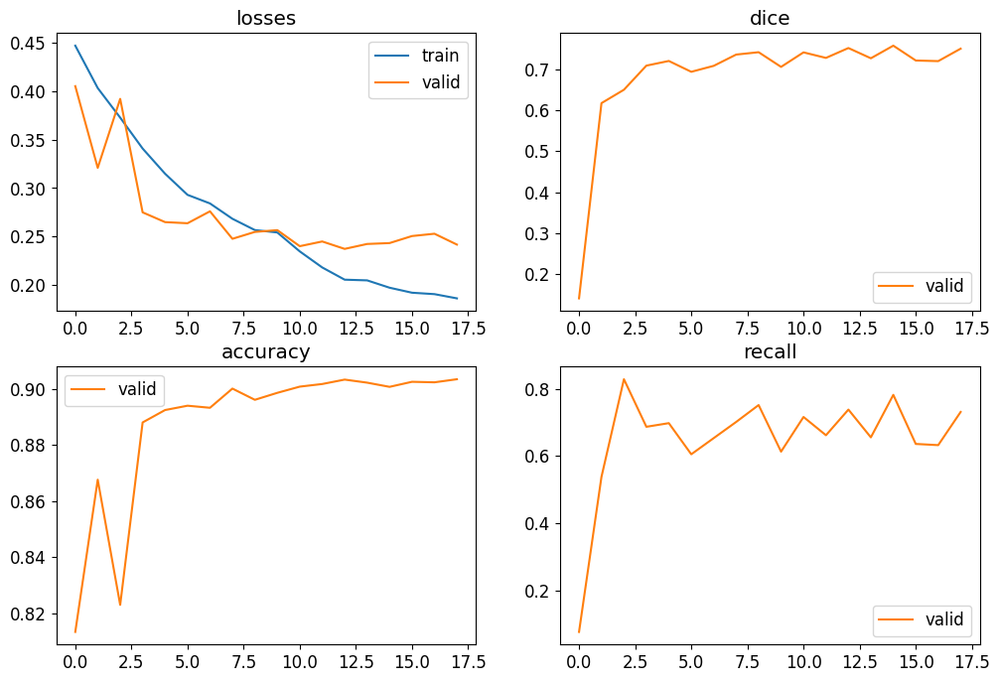

In [ ]:
# Mostar resultados
learn1.recorder.plot_metrics()

Tras entrenar el modelo, comparamos las predicciones realizadas con respecto de las salidas reales.

Los resultados obtenidos en la segmentación son muy buenos, alcanzando aproximadamente un 90% de precisión. Aunque existen algunas pequeñas áreas donde el modelo no clasifica correctamente las zonas enfermas, la mayoría de las regiones afectadas son detectadas con precisión. Esto indica que el modelo es efectivo en identificar la enfermedad en las hojas, capturando de manera precisa las áreas críticas.

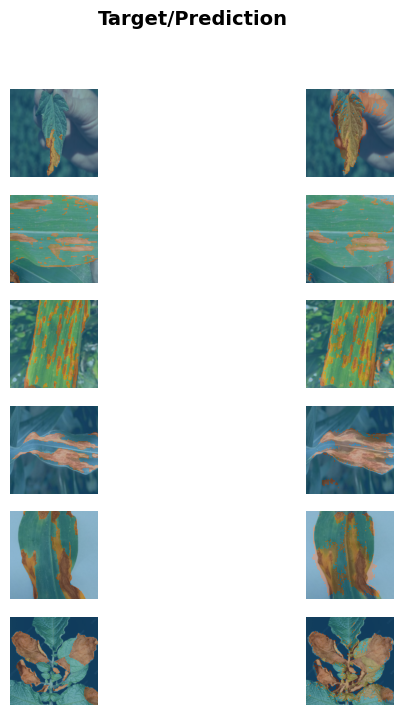

In [ ]:
learn1.show_results(max_n=6, figsize=(7,8))

Exportamos este modelo.

In [ ]:
export_path = '/content/drive/MyDrive/leaf_segmentation/disease_segmentation_model.pkl'  # Ruta donde guardarás el modelo
learn1.export(export_path)

# 2. Cargar el modelo exportado
loaded_disease_segmentation_model = load_learner(export_path)

### **Entrenamiento modelo 2 ( `BCEWithLogitsLossFlat` con pesos personalizados)**

In [ ]:
learn2 = unet_learner(
    dls,
    resnet34,
    loss_func=CustomBCEWithLogitsLossFlat(pos_weight=pos_weight),
    metrics=[Dice(),Accuracy(),Recall()],
    n_out=1
)

learn2.summary()

DynamicUnet (Input shape: 16 x 3 x 256 x 256)
Layer (type)         Output Shape         Param #    Trainable 
                     16 x 64 x 128 x 128 
Conv2d                                    9408       False     
BatchNorm2d                               128        True      
ReLU                                                           
____________________________________________________________________________
                     16 x 64 x 64 x 64   
MaxPool2d                                                      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                                                           
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                     

/usr/local/lib/python3.10/dist-packages/fastai/learner.py:53: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state = torch.load(file, map_location=device, **torch_load_kwargs

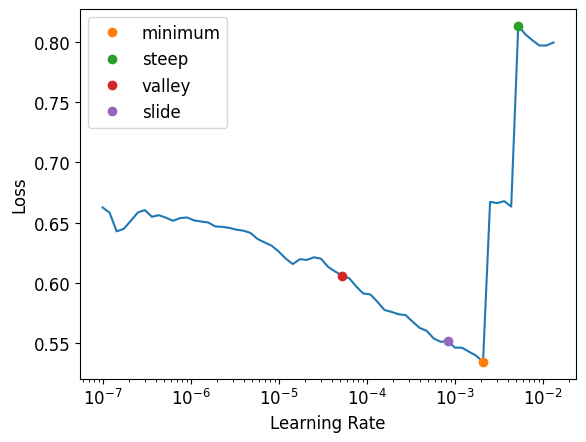

In [ ]:
lrs = learn2.lr_find(suggest_funcs=(minimum, steep, valley, slide))

In [ ]:
learn2.fine_tune(20, base_lr=lrs.valley, cbs=[SaveModelCallback(),EarlyStoppingCallback(min_delta=0.01, patience=5)])

epoch,train_loss,valid_loss,dice,accuracy,recall,time
0,0.542309,0.420083,0.504169,0.849967,0.384223,00:23


Better model found at epoch 0 with valid_loss value: 0.42008307576179504.


epoch,train_loss,valid_loss,dice,accuracy,recall,time
0,0.385444,0.358030,0.450040,0.851691,0.305660,00:24
1,0.366039,0.349624,0.649852,0.855956,0.673302,00:25
2,0.352556,0.304447,0.645488,0.877468,0.561898,00:24
3,0.330579,0.422794,0.626896,0.798845,0.851236,00:24
4,0.323510,0.284990,0.667188,0.886558,0.572764,00:23
5,0.309758,0.270972,0.710359,0.891060,0.672915,00:23
6,0.298246,0.274840,0.722501,0.888448,0.731484,00:25
7,0.286956,0.277031,0.726962,0.885956,0.764736,00:23
8,0.278330,0.261564,0.732004,0.894789,0.723768,00:25
9,0.263943,0.274912,0.733076,0.884698,0.797537,00:23


Better model found at epoch 0 with valid_loss value: 0.3580304682254791.
Better model found at epoch 1 with valid_loss value: 0.34962373971939087.
Better model found at epoch 2 with valid_loss value: 0.304447203874588.
Better model found at epoch 4 with valid_loss value: 0.2849896252155304.
Better model found at epoch 5 with valid_loss value: 0.27097243070602417.
Better model found at epoch 8 with valid_loss value: 0.26156413555145264.
Better model found at epoch 10 with valid_loss value: 0.2542267143726349.
Better model found at epoch 12 with valid_loss value: 0.24964730441570282.
No improvement since epoch 10: early stopping


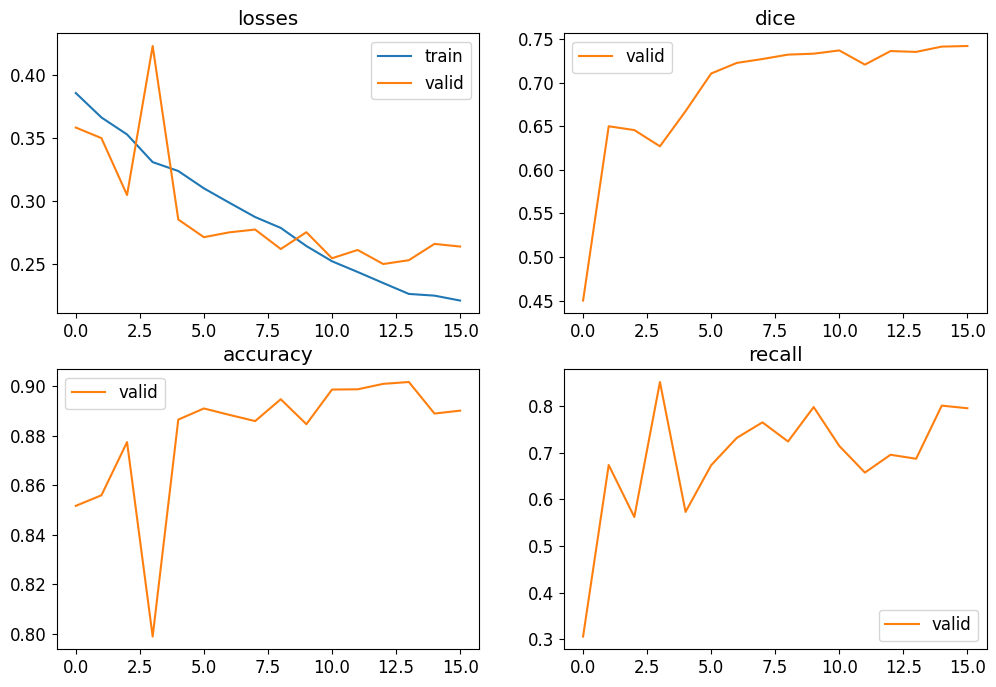

In [ ]:
# Mostar resultados
learn2.recorder.plot_metrics()

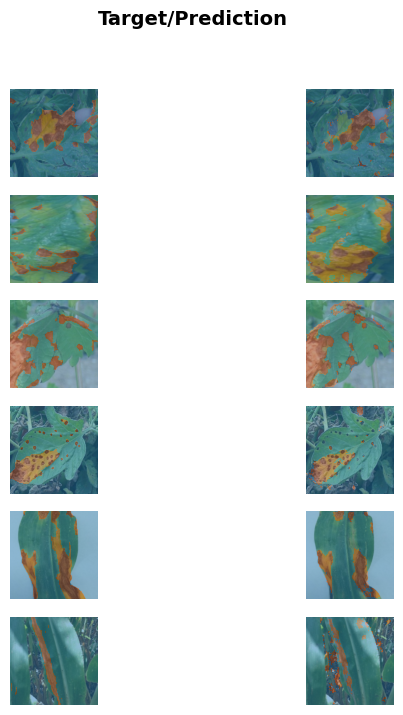

In [ ]:
learn2.show_results(max_n=6, figsize=(7,8))

### **Rendimiento del modelo en test**

In [ ]:
test_dl = learn1.dls.test_dl(get_image_files(test_images_path),with_labels=True)
preds, targs, _ = learn1.get_preds(dl=test_dl, with_decoded=True)

In [ ]:
preds_prob = preds.sigmoid()
preds_bin = (preds_prob > 0.5).float()
preds_bin = preds_bin.squeeze(1)
preds_bin[0].shape

torch.Size([256, 256])

In [ ]:
def recall(pred, targ):
    pred, targ = pred.flatten(), targ.flatten()  # Aplanar las máscaras
    tp = (pred * targ).sum()  # Verdaderos positivos
    fn = targ.sum() - tp      # Falsos negativos
    return tp / (tp + fn + 1e-8)

recall_scores = [recall(preds_bin[i], targs[i]) for i in range(len(preds_bin))]
mean_recall = sum(recall_scores) / len(recall_scores)
print(f"Mean Recall: {mean_recall}")

Mean Recall: TensorBase(1.)


In [ ]:
def accuracy(pred, targ):
    pred, targ = pred.flatten(), targ.flatten()  # Aplanar las máscaras
    return (pred == targ).float().mean()

accuracy_scores = [accuracy(preds_bin[i], targs[i]) for i in range(len(preds_bin))]
mean_accuracy = sum(accuracy_scores) / len(accuracy_scores)
print(f"Mean Accuracy: {mean_accuracy}")

Mean Accuracy: TensorBase(0.2090)


### **Mostrar Resultados Finales**

En la siguienta tabla se recoge los distintos modelos entrenados junto a sus métricas.

In [ ]:
# Definir la tabla de resultados correctamente como lista de diccionarios
tabla_resultados = [
    {"Modelo": "Hojas segmentadas - Resnet34", "Loss": "0.233266", "Accuracy": "0.903190", "Dice": "/", "Recall": "0.657050"},
    {"Modelo": "Hojas segmentadas - Resnet34 con pesos", "Loss": "0.232712", "Accuracy": "0.903047", "Dice": "/", "Recall": "0.692462"},
    {"Modelo": "Segmentación zona infectada - Resnet34", "Loss": "0.391960", "Accuracy": "0.822960", "Dice": "0.650103", "Recall": "0.828449"},
    {"Modelo": "Segmentación zona infectada - Resnet34 con pesos", "Loss": "0.249647", "Accuracy": "0.901009", "Dice": "0.736064", "Recall": "0.695288"}
]

# Crear el DataFrame a partir de la lista
tabla = pd.DataFrame(tabla_resultados)

# Estilizar el DataFrame para centrar las columnas, aumentar el espacio entre ellas y eliminar los índices
styled_df = tabla.style.set_table_styles(
    [{'selector': 'th', 'props': [('text-align', 'start'), ('padding', '10px')]},  # Centrar los encabezados
     {'selector': 'td', 'props': [('text-align', 'start'), ('padding', '10px')]}]  # Centrar las celdas y aumentar padding
).set_table_attributes('style="width: 100%; border-collapse: separate; border-spacing: 10px;"')

# Mostrar el DataFrame con estilo
styled_df.hide(axis="index")


Modelo,Loss,Accuracy,Dice,Recall
Hojas segmentadas - Resnet34,0.233266,0.903190,/,0.657050
Hojas segmentadas - Resnet34 con pesos,0.232712,0.903047,/,0.692462
Segmentación zona infectada - Resnet34,0.391960,0.822960,0.650103,0.828449
Segmentación zona infectada - Resnet34 con pesos,0.249647,0.901009,0.736064,0.695288


# Porcentaje de zonas enfermas

Se toman las máscaras de los dos entrenamientos de la segunda red y se dividen entre  las máscaras resultantes del primer entrenamiento.

In [ ]:
# Cargar los modelos exportado
leaf_loaded_model = load_learner("/content/drive/MyDrive/leaf_segmentation/leaf_segmentation_model.pkl")
disease_loaded_model = load_learner("/content/drive/MyDrive/leaf_segmentation/disease_segmentation_model.pkl")

Escogemos 5 imágenes para mostrar su porcentaje de enfermedad predicho junto al real.

In [ ]:
def calcular_porcentaje_enfermedad(image_path):
    # Obtener la máscara binaria de la enfermedad
    enfermedad_mask = get_mask(image_path)

    # Obtener la máscara binaria de la hoja
    hoja_mask = get_mask(image_path, True)

    # Calcular el área total de la hoja
    total_hoja_area = np.sum(hoja_mask == 1)

    # Calcular el área total de la enfermedad (intersección)
    total_enfermedad_area = np.sum((enfermedad_mask == 1) & (hoja_mask == 1))

    # Calcular el porcentaje de infección
    if total_hoja_area > 0:
        infection_percentage = (total_enfermedad_area / total_hoja_area) * 100
    else:
        infection_percentage = 0  # Si el área de la hoja es cero, la infección también es cero

    # Imprimir resultados
    print(f"El porcentaje de infección 'REAL' es: {infection_percentage:.2f}%")
    return infection_percentage

Área total de la hoja: 43934 píxeles
Área total de la hoja infectada: 12287 píxeles
El porcentaje predicho de infección es: 27.97%
El porcentaje de infección 'REAL' es: 17.89%


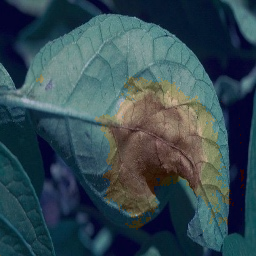

Área total de la hoja: 47529 píxeles
Área total de la hoja infectada: 8839 píxeles
El porcentaje predicho de infección es: 18.60%
El porcentaje de infección 'REAL' es: 14.74%


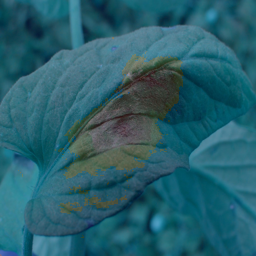

Área total de la hoja: 57460 píxeles
Área total de la hoja infectada: 51431 píxeles
El porcentaje predicho de infección es: 89.51%
El porcentaje de infección 'REAL' es: 95.18%


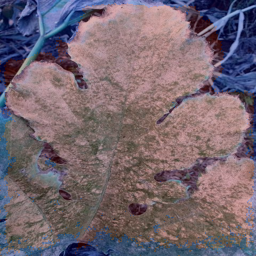

Área total de la hoja: 50709 píxeles
Área total de la hoja infectada: 16710 píxeles
El porcentaje predicho de infección es: 32.95%
El porcentaje de infección 'REAL' es: 17.56%


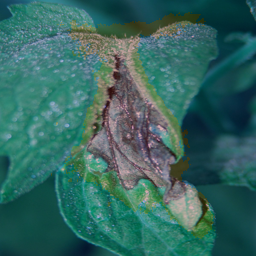

Área total de la hoja: 50743 píxeles
Área total de la hoja infectada: 3780 píxeles
El porcentaje predicho de infección es: 7.45%
El porcentaje de infección 'REAL' es: 4.29%


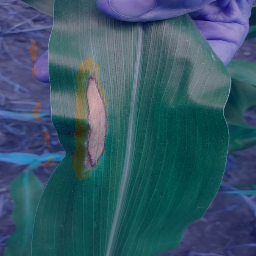

In [ ]:
from google.colab.patches import cv2_imshow
shuffled_files = image_files.copy()
random.shuffle(shuffled_files)

for i, img_path in enumerate(shuffled_files[:5]):
    # Cargar y redimensionar la imagen original
    img_path = Path(img_path)
    original_image = Image.open(img_path)
    resized_image = original_image.resize((256, 256))  # Redimensionar a 256x256
    resized_image_np = np.array(resized_image)  # Convertir a array numpy para OpenCV

    # Guardar la imagen redimensionada temporalmente
    temp_path = '/content/temp_resized_image.jpg'
    resized_image.save(temp_path)

    # Predicción con el modelo de la hoja segmentada
    pred_mask, _, _ = leaf_loaded_model.predict(temp_path)
    pred_mask_np = np.array(pred_mask[0])  # Convertir la máscara a array numpy
    binary_mask = (pred_mask_np > 0.5).astype(np.uint8) * 255  # Umbralizar la máscara

    # Predicción con el modelo de la hoja sin segmentar (enfermedad)
    pred_mask, _, _ = disease_loaded_model.predict(temp_path)
    pred_mask_np = np.array(pred_mask[0])  # Convertir la máscara a array numpy
    binary_mask_2 = (pred_mask_np > 0.5).astype(np.uint8) * 255  # Umbralizar la máscara

    # Aplicar la máscara binaria predicha a la máscara original redimensionada
    segmented_mask = cv2.bitwise_and(binary_mask_2, binary_mask_2, mask=binary_mask)

    # Superponer la máscara sobre la imagen original redimensionada
    colored_mask = cv2.applyColorMap(segmented_mask, cv2.COLORMAP_JET)  # Aplicar un mapa de color
    overlay = cv2.addWeighted(resized_image_np, 0.7, colored_mask, 0.3, 0)  # Superponer con transparencia

    # Calcular las áreas y el porcentaje de infección
    total_hoja_area = np.sum(binary_mask == 255)
    total_hoja_infectada = np.sum(segmented_mask == 255)
    infection_percentage = (total_hoja_infectada / total_hoja_area) * 100

    print(f"Área total de la hoja: {total_hoja_area} píxeles")
    print(f"Área total de la hoja infectada: {total_hoja_infectada} píxeles")
    print(f"El porcentaje predicho de infección es: {infection_percentage:.2f}%")
    calcular_porcentaje_enfermedad(img_path)
    cv2_imshow(overlay) # Mostrar la imagen superpuesta
    print("\n\n")